This notebook compares the EnKF with no localization, standard covariance localization, and what I am calling SVD localization.
Each of the three localization methods are cycled with Lorenz Model III (Lorenz, 2005).

Idea behind SVD localization is to use the leading directions of the sample correlation of a coarse but large ensemble of $X$ as the leading directions of the small but fine ensemble of $Z$.
$$
C_X = \mbox{corr}(X)
$$

$$
U S V^{T} = C_X
$$

This is on a coarse scale and must be interpolated to the finer $Z$ scale resulting in $\tilde{V}$.

$$
C_Z = \mbox{corr}(Z)
$$

$$
C_{Z}^{\parallel} = \tilde{V} \mbox{diag}( \mbox{diag}( \tilde{V}^T C_Z \tilde{V} ) ) \tilde{V}^T
$$

$$
C_{Z}^{\bot} = C_Z - C_Z^{\parallel}
$$

$$
C_{Z}^{loc} = C_Z^{\parallel} + C_{\rho} \circ C_Z^{\bot}
$$

$$
P_Z^{loc} = D^{1/2} C_Z^{loc} D^{1/2}
$$

Where $C_{\rho}$ is a localization matrix for the fine scale correlation function, and $D$ is a diagonal matrix with the sample vairance of $Z$ on the diagonal.

The results in this notebook suggest that the covariance matrix that is generated from this process is useful.
I have not tuned localization or inflation yet.
I am now working on using this in the context of the linear transformations derived from $R^{-1/2}HP^{1/2}$.

In [1]:
import importlib
import time
import numpy as np
import scipy as sp
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt
from scipy import ndimage
from scipy import integrate
from scipy import interpolate
import os
import pickle

/Users/harty/miniconda3/envs/loc/lib/python3.7/site-packages/matplotlib/font_manager.py:232: UserWarning: Matplotlib is building the font cache using fc-list. This may take a moment.
  'Matplotlib is building the font cache using fc-list. '


In [2]:
from multi_loc import covariance, assimilate, utilities

In [3]:
%matplotlib inline

In [4]:
def imshow(X, title=None, vmin=None, vmax=None, cmap=None):
    plt.figure()
    im = plt.imshow(X, vmin=vmin, vmax=vmax, cmap=cmap)
    plt.colorbar(im)
    plt.title(title)

In [9]:
load_files = False

In [10]:
if not load_files:
    N_Z = 960
    K = 32
    I = 12
    F = float(15)
    b = float(10)
    c = float(2.5)
    alpha = (3 * I**2 + 3) / (2 * I**3 + 4 * I)
    beta = (2 * I**2 + 1) / (I**4 + 2 * I**2)
    LM3_params = {'K': K,
                  'I': I,
                  'F': F,
                  'b': b,
                  'c': c,
                  'alpha': alpha,
                  'beta': beta}

    coarse = 8
    N_Xc = N_Z//coarse
    K_c = K//coarse
    N_eZ = 10
    N_eX = 200


    x_Z = np.arange(N_Z)
    x_Xc = x_Z[::coarse]

    dt = 0.01
    dt_obs = 0.1

    N_obs = int(N_Z/8)

    T_ens = 1000
    T_ic = 100
    T_KF = 30

    N_t_KF = int(T_KF/dt + 1)
    t_kf = np.round(np.linspace(0, T_KF, N_t_KF), 2)


    KF_params = {'coarse': coarse,
                 'N_Xc': N_Xc,
                 'K_c': K_c,
                 'N_eZ': N_eZ,
                 'N_eX': N_eX,
                 'dt': dt,
                 'dt_obs': dt_obs,
                 'T_ens': T_ens,
                 'T_ic': T_ic,
                 'T_KF': T_KF}

    home = os.path.expanduser('~')
    dir_name = f'{home}/Documents/python_code/multi_loc/notebooks/first_cycle_run/'

    if not os.path.exists(dir_name):
        os.mkdir(dir_name)
    
    this_path = os.path.join(dir_name, 'LM3_params.pkl')
    with open(this_path, mode='wb') as f:
        pickle.dump(LM3_params, f)

    this_path = os.path.join(dir_name, 'KF_params.pkl')
    with open(this_path, mode='wb') as f:
        pickle.dump(KF_params, f)

# Long run to generate ensemble

In [12]:
this_path = os.path.join(dir_name, 'Z_long_run.npy')

if not load_files:
    X_interp = np.random.uniform(low=-5, high=10, size=N_Z//K)
    X_interp = np.concatenate([X_interp, [X_interp[0]]])
    x = np.arange(N_Z)
    x_interp = x[::K]
    x_interp = np.concatenate([x_interp, [x[-1] + 1]])
    f_X = interpolate.interp1d(x_interp, X_interp, kind='quadratic')
    X0 = f_X(x)
    Y0 = np.random.uniform(low=-0.5, high=1, size=N_Z)
    Z0 = X0 + X0*Y0/X0.max()
    N_t_ic = int(T_ic/dt + 1)
    t = np.linspace(0, T_ic, N_t_ic)
    Z = utilities.return_LM3_data(Z0, t, **LM3_params)
    Z0 = Z[:, -1]

    N_t_ens = int(T_ens/dt + 1)
    t = np.linspace(0, T_ens, N_t_ens)
    Z = utilities.return_LM3_data(Z0, t, **LM3_params)

    np.save(this_path, Z)
else:
    Z = np.load(this_path)

# Generate ensemble from long run

In [13]:
if not load_files:
    X0_ens, Z0_ens = utilities.generate_X_Z_LM3_ens(
        Z, N_eX, N_eZ, coarse, I, alpha, beta)
    
    this_path = os.path.join(dir_name, 'X0_ens.npy')
    np.save(this_path, X0_ens)
    this_path = os.path.join(dir_name, 'Z0_ens.npy')
    np.save(this_path, Z0_ens)
else:
    this_path = os.path.join(dir_name, 'X0_ens.npy')
    X0_ens = np.load(this_path)
    this_path = os.path.join(dir_name, 'Z0_ens.npy')
    Z0_ens = np.load(this_path)

# Set up ground truth and time series

In [14]:
this_path = os.path.join(dir_name, 'Z_GT.npy')

if not load_files:
    X_interp = np.random.uniform(low=-5, high=10, size=N_Z//K)
    X_interp = np.concatenate([X_interp, [X_interp[0]]])
    x = np.arange(N_Z)
    x_interp = x[::K]
    x_interp = np.concatenate([x_interp, [x[-1] + 1]])
    f_X = interpolate.interp1d(x_interp, X_interp, kind='quadratic')
    X0 = f_X(x)
    Y0 = np.random.uniform(low=-0.5, high=1, size=N_Z)
    Z0 = X0 + X0*Y0/X0.max()
    N_t_ic = int(T_ic/dt + 1)
    t = np.linspace(0, T_ic, N_t_ic)
    Z = utilities.return_LM3_data(Z0, t, **LM3_params)
    Z0 = Z[:, -1]
    Z_GT = utilities.return_LM3_data(Z0, t_kf, **LM3_params)
    np.save(this_path, Z_GT)
else:
    Z_GT = np.load(this_path)

In [15]:
X_GT = utilities.window_sum_Z(Z_GT, I=I, alpha=alpha, beta=beta)
Y_GT = Z_GT - X_GT

In [16]:
Zloc = np.arange(N_Z)

Z_ts = xr.DataArray(Z_GT,
                    dims=('loc', 'time'),
                    coords={'loc': Zloc,
                            'time': t_kf})
X_ts = xr.DataArray(X_GT,
                    dims=('loc', 'time'),
                    coords={'loc': Zloc,
                            'time': t_kf})
Y_ts = xr.DataArray(Y_GT,
                    dims=('loc', 'time'),
                    coords={'loc': Zloc,
                            'time': t_kf})

X0_ens_temp = utilities.window_sum_Z(Z0_ens, I=I, alpha=alpha, beta=beta)
Y0_ens = Z0_ens - X0_ens_temp

# Looking at the ensembles

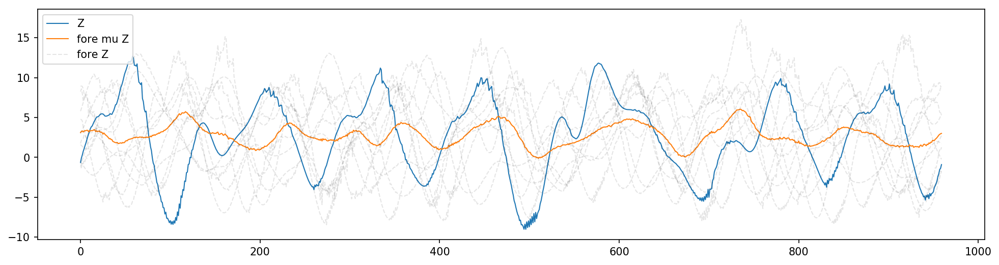

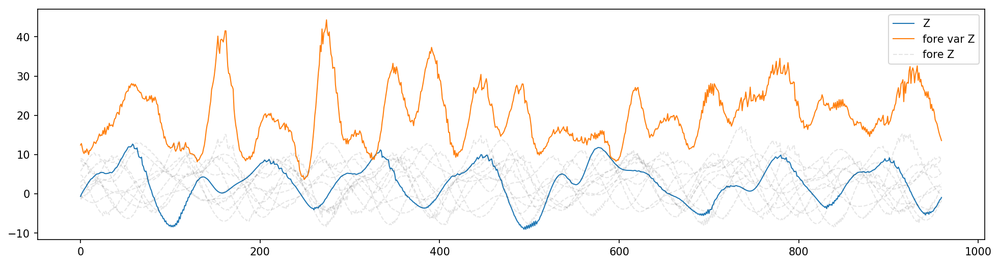

In [17]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.isel(time=0), linewidth=1)
plt.plot(np.mean(Z0_ens, axis=-1), linewidth=1)
plt.plot(Z0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'fore mu Z', 'fore Z'])

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.isel(time=0), linewidth=1)
plt.plot(np.var(Z0_ens, axis=-1), linewidth=1)
plt.plot(Z0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Z', 'fore var Z', 'fore Z'])

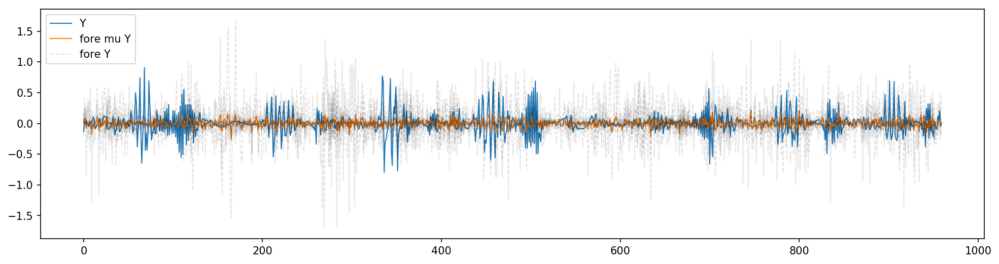

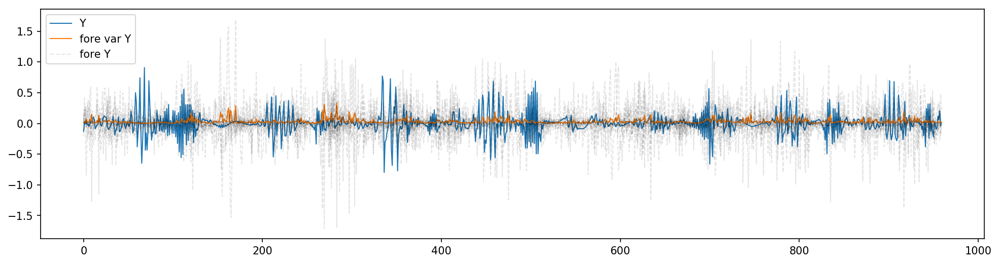

In [18]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_ts.isel(time=0), linewidth=1)
plt.plot(np.mean(Y0_ens, axis=-1), linewidth=1)
plt.plot(Y0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Y', 'fore mu Y', 'fore Y'])

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Y_ts.isel(time=0), linewidth=1)
plt.plot(np.var(Y0_ens, axis=-1), linewidth=1)
plt.plot(Y0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['Y', 'fore var Y', 'fore Y'])

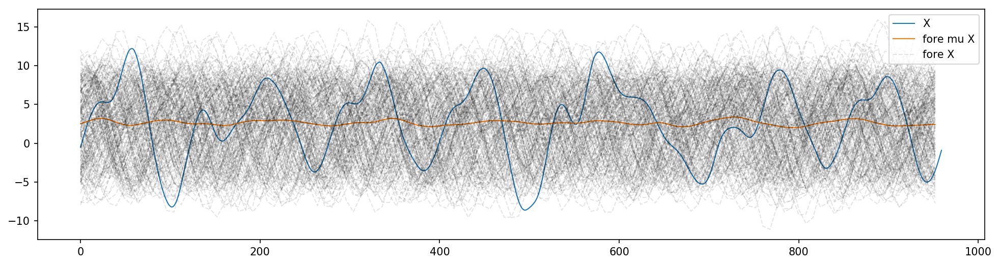

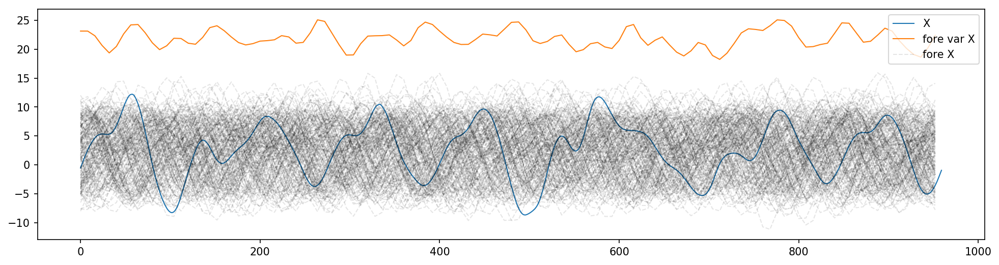

In [19]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(X_ts.isel(time=0), linewidth=1)
plt.plot(x_Xc, np.mean(X0_ens, axis=-1), linewidth=1)
plt.plot(x_Xc, X0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['X', 'fore mu X', 'fore X'])

figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(X_ts.isel(time=0), linewidth=1)
plt.plot(x_Xc, np.var(X0_ens, axis=-1), linewidth=1)
plt.plot(x_Xc, X0_ens, 'k--', alpha=.1, linewidth=1)
plt.legend(['X', 'fore var X', 'fore X'])

# Generate observations and related matices

In [20]:
H_sub = np.eye(N_Xc)
R_sub = 1 * np.eye(N_Xc)

In [21]:
# random obs

Z_obs_loc = np.random.choice(N_Z, N_obs)
Z_obs_loc.sort()

R_Z_sd = 0.5

R_Z = R_Z_sd**2 * np.eye(N_obs)
H_Z = np.eye(N_Z)[Z_obs_loc]

In [22]:
# # dense and coarse obs network


# co_spacing = 2
# den_patches = 0
# # patch_size = 15
# patch_size = 25

# Zc_obs_loc = np.arange(N_Z)[::co_spacing]
# # Zc_obs_loc = np.array([])

# dense_patch = np.arange(-patch_size//2, patch_size//2 + 1)
# dense_patch_loc = np.random.choice(N_Z, size=den_patches, replace=False)
# Zd_obs_loc = dense_patch_loc[:, None] + dense_patch[None, :]
# Zd_obs_loc = Zd_obs_loc.ravel() % N_Z
# Zd_obs_loc = np.unique(Zd_obs_loc)
# Zd_obs_loc.sort()

# Z_obs_loc = np.concatenate([Zc_obs_loc, Zd_obs_loc])

# N_co = Zc_obs_loc.size
# N_do = Zd_obs_loc.size
# print('Coarse obs size: ', N_co)
# print('Dense obs size: ', N_do)

# # R and H for Z

# R_Zc_sd = 0.5
# R_Zd_sd = 0.1
# R_Z = np.diag(np.concatenate([R_Zc_sd**2 * np.ones(N_co), R_Zd_sd**2 * np.ones(N_do)]))
# # R_Z = np.diag(R_Zd_sd**2 * np.ones(N_do))

# H_coar = np.eye(N_Z)[Zc_obs_loc]
# H_dense = np.eye(N_Z)[Zd_obs_loc]
# H_Z = np.concatenate([H_coar, H_dense], axis=0)
# # H_Z = H_dense

# R and H for X

In [23]:
R_Xc_sd = 1
R_Xc = (R_Xc_sd**2) * np.eye(N_Xc)
H_Xc = np.eye(N_Xc)

H_f2c = np.eye(N_Z)[::coarse]
X_obs_loc = np.arange(N_Z)[::coarse]

In [25]:
every_t = int(dt_obs/dt)
t_obs = t_kf[::every_t]

Z_obs_ts = H_Z @ Z_ts.sel(time=t_obs).values
X_obs_ts = H_f2c @ X_ts.sel(time=t_obs).values

In [26]:
Z_obs_ts = Z_obs_ts + np.random.multivariate_normal(np.zeros(N_obs), R_Z, t_obs.size).T
X_obs_ts = X_obs_ts + np.random.multivariate_normal(np.zeros(N_Xc), R_Xc, t_obs.size).T

Z_obs_ts = xr.DataArray(Z_obs_ts,
                        dims=('loc', 'time'),
                        coords={'loc': Z_obs_loc,
                                'time': t_obs})
X_obs_ts = xr.DataArray(X_obs_ts,
                        dims=('loc', 'time'),
                        coords={'loc': X_obs_loc,
                                'time': t_obs})

In [27]:
%matplotlib inline

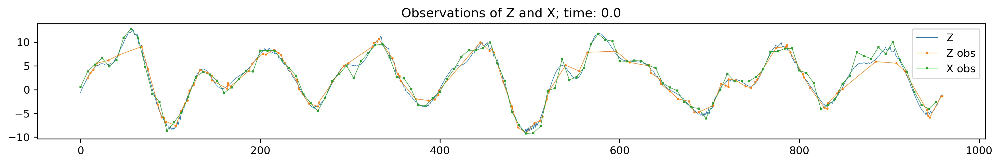

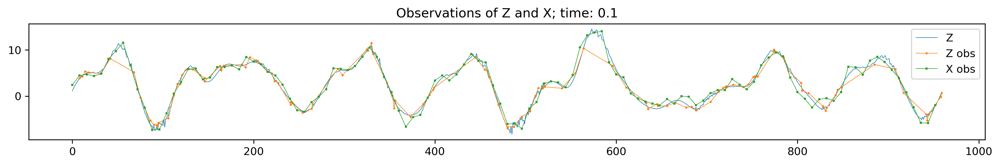

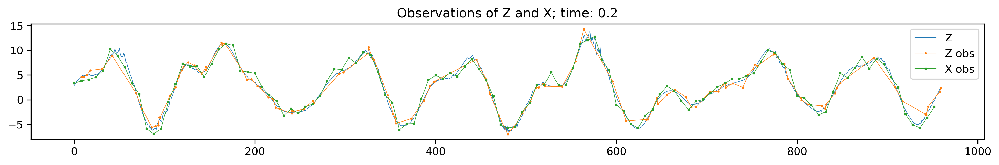

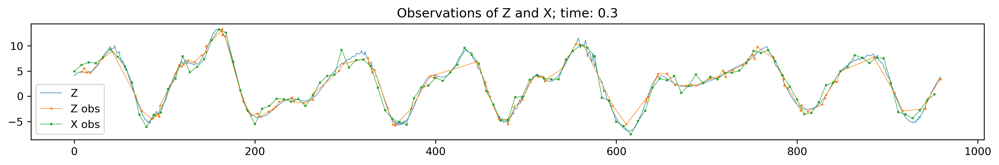

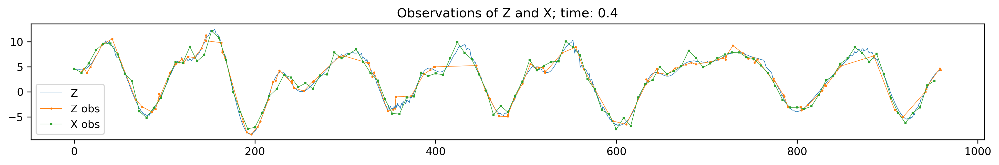

...

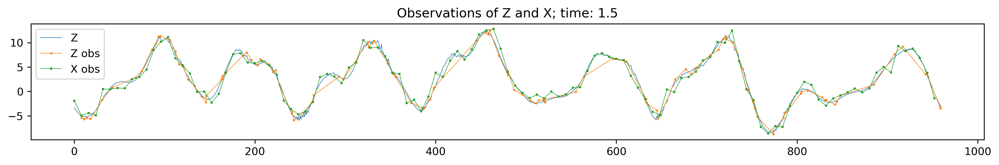

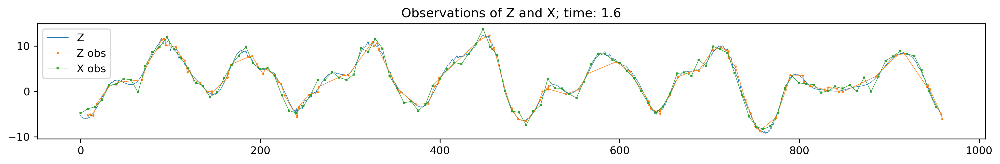

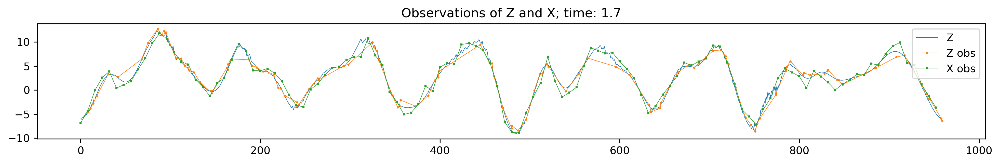

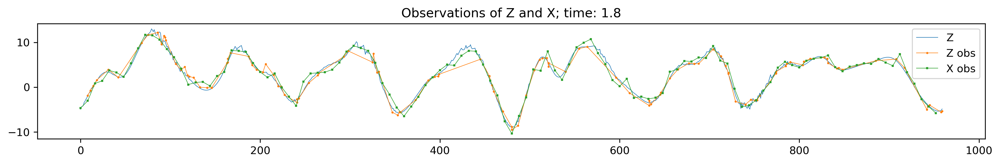

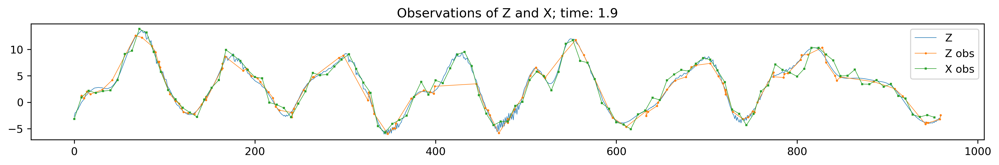

In [28]:
for at in Z_obs_ts.time.values[:20]:    
    figsize = plt.figaspect(1/8)
    plt.figure(dpi=300, figsize=figsize)
    plt.plot(Z_ts.sel(time=at), linewidth=0.5)
    plt.plot(Z_obs_loc, Z_obs_ts.sel(time=at), '-o', markersize=1, linewidth=0.5)
    plt.plot(X_obs_loc, X_obs_ts.sel(time=at), '-s', markersize=1, linewidth=0.5)
    plt.legend(['Z', 'Z obs', 'X obs'])
    plt.title(f'Observations of Z and X; time: {at}')

# Assim one observation

# No localization

In [29]:
atitle = 'No loc'

In [30]:
importlib.reload(assimilate)
importlib.reload(utilities)

# rho0_Zf = 5
# rho_Zf = np.arange(N_Z)
# rho_Zf = np.minimum(np.abs(N_Z - rho_Zf)%N_Z, rho_Zf)
# rho_Zf = np.exp(-(rho_Zf**2)/(2*rho0_Zf**2))
# rho_Zf = sp.linalg.circulant(rho_Zf)
# # imshow(rho_Zf, 'rho Zf',
# #        vmin=0, vmax=1)
# # imshow(rho_Zf[:20, :20], 'rho Zf zoom',
# #        vmin=0, vmax=1)

# rho0_Zc = 100
# rho_Zc = np.arange(N_Z)
# rho_Zc = np.minimum(np.abs(N_Z - rho_Zc)%N_Z, rho_Zc)
# rho_Zc = np.exp(-(rho_Zc**2)/(2*rho0_Zc**2))
# rho_Zc = sp.linalg.circulant(rho_Zc)
# imshow(rho_Zc, 'rho Zc',
#        vmin=0, vmax=1)
rho_Zc = None



# assim_type = 'SVD_loc'
assim_type = 'standard loc'
return_details = True
X_ens_a, Z_ens_a, details = assimilate.dual_scale_enkf(
    X_ens=X0_ens, X_obs=X_obs_ts.isel(time=0).values, H_X=H_Xc, R_X=R_Xc,
    Z_ens=Z0_ens, Z_obs=Z_obs_ts.isel(time=0).values, H_Z=H_Z, R_Z=R_Z,
    H_sub=H_sub, R_sub=R_sub, coarse=coarse,
    rho_Zc=rho_Zc,
    assim_type=assim_type, return_details=return_details)

In [31]:
%matplotlib inline

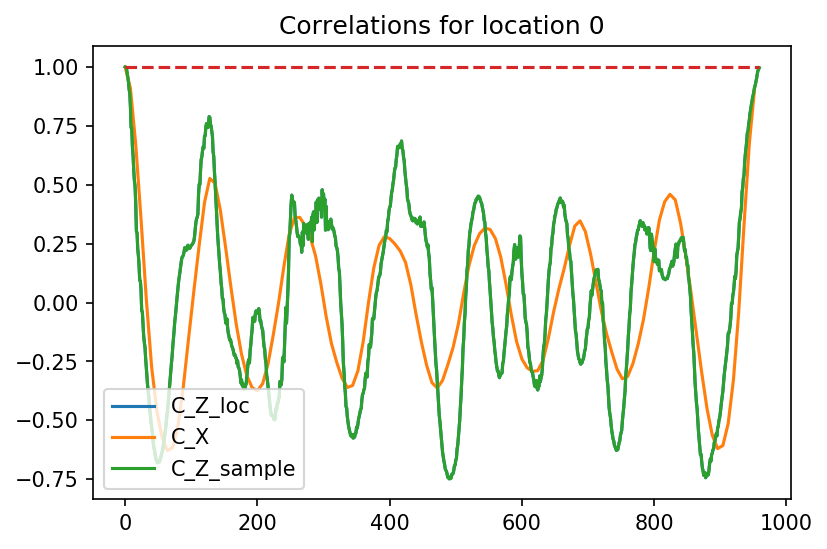

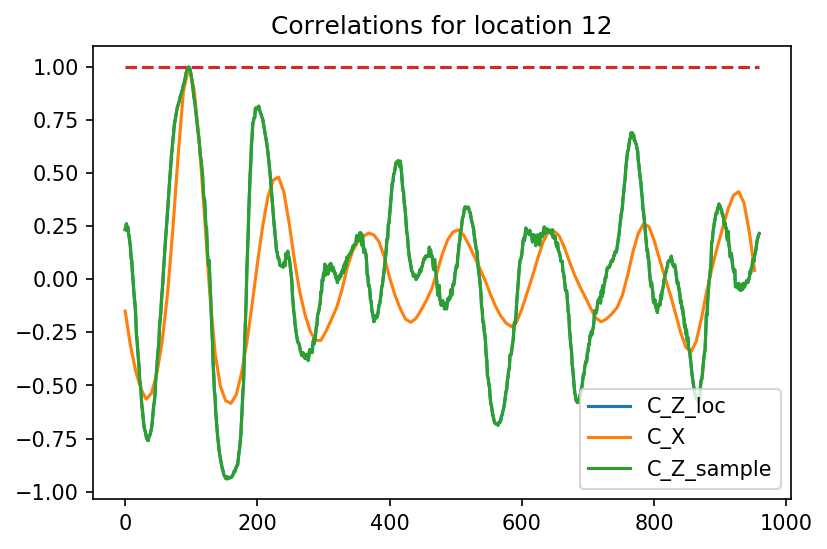

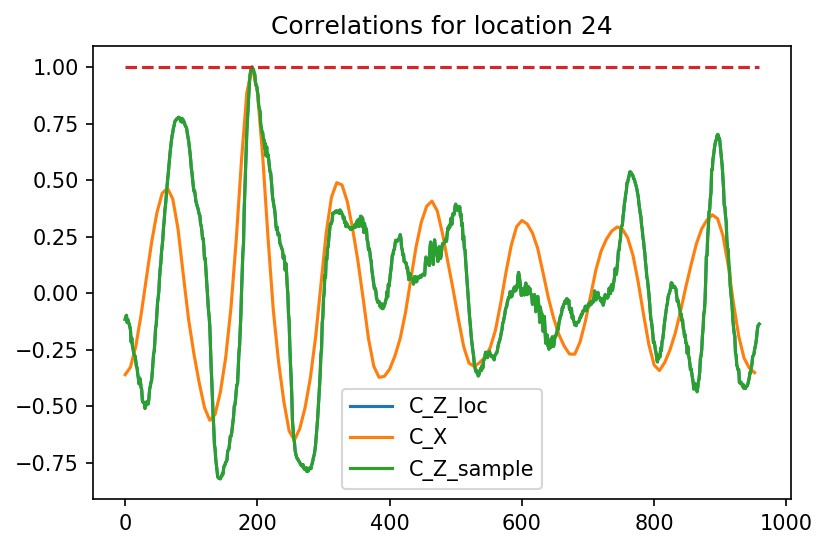

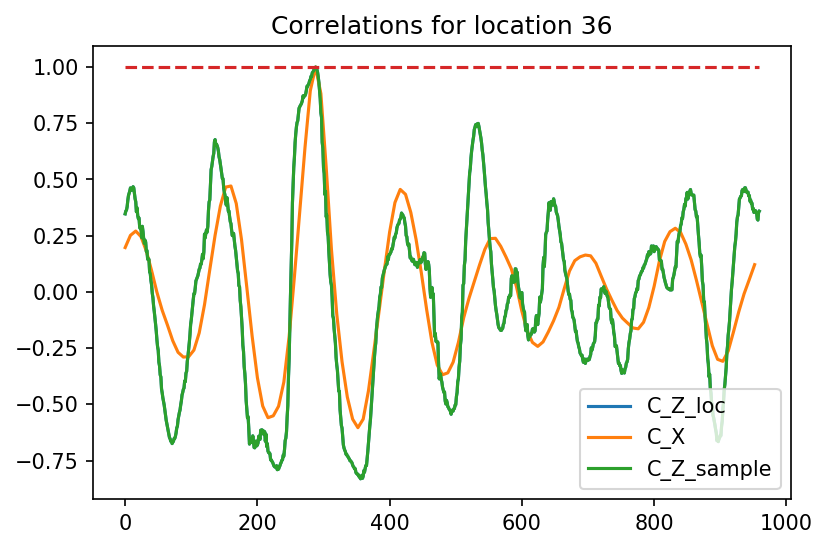

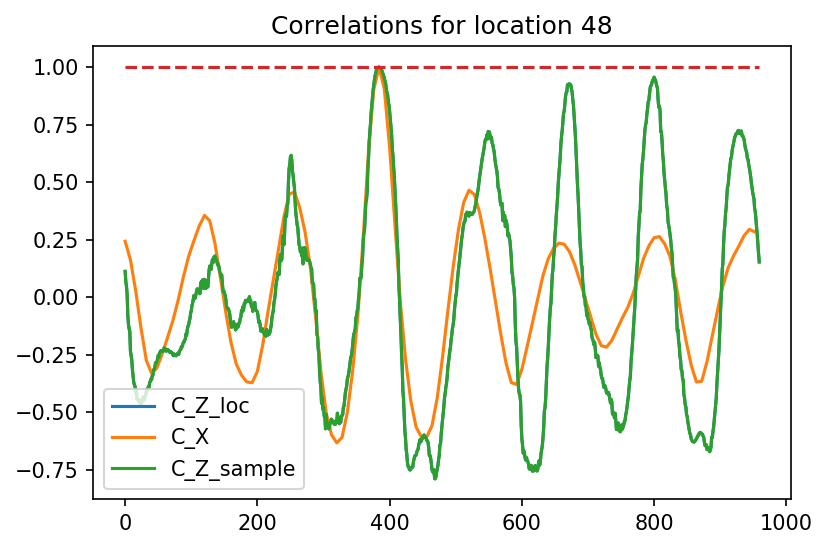

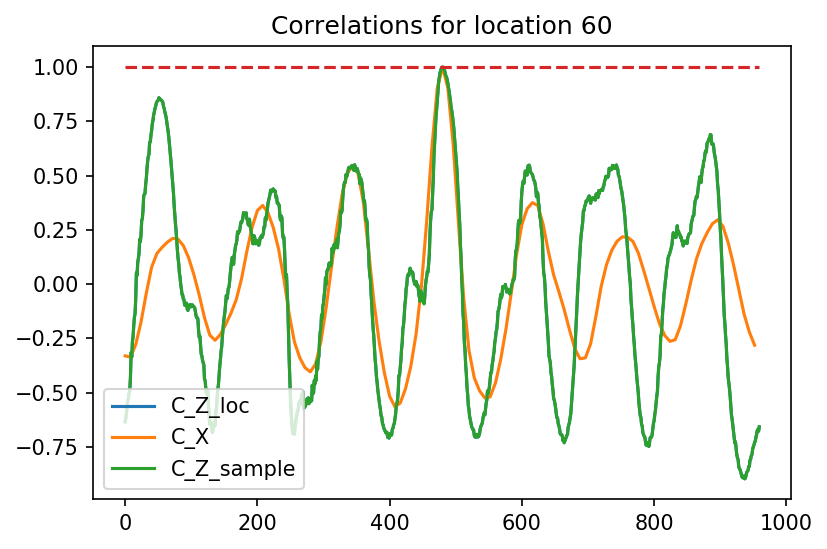

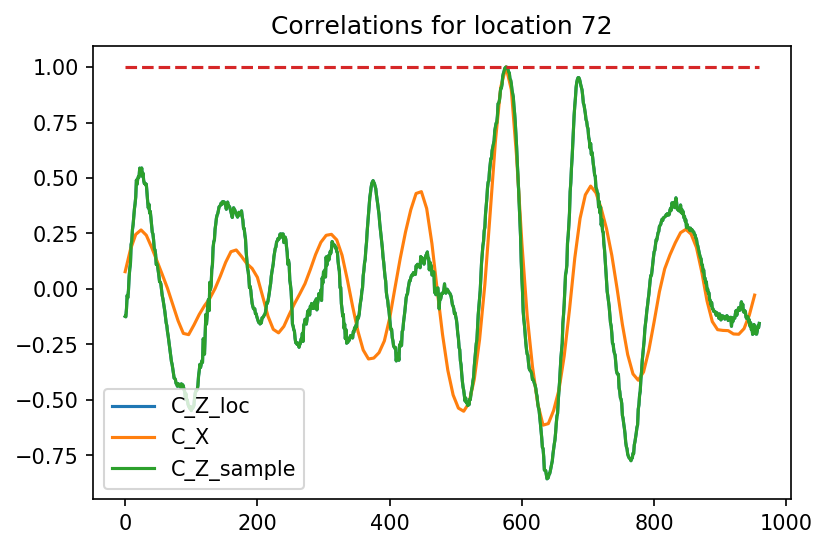

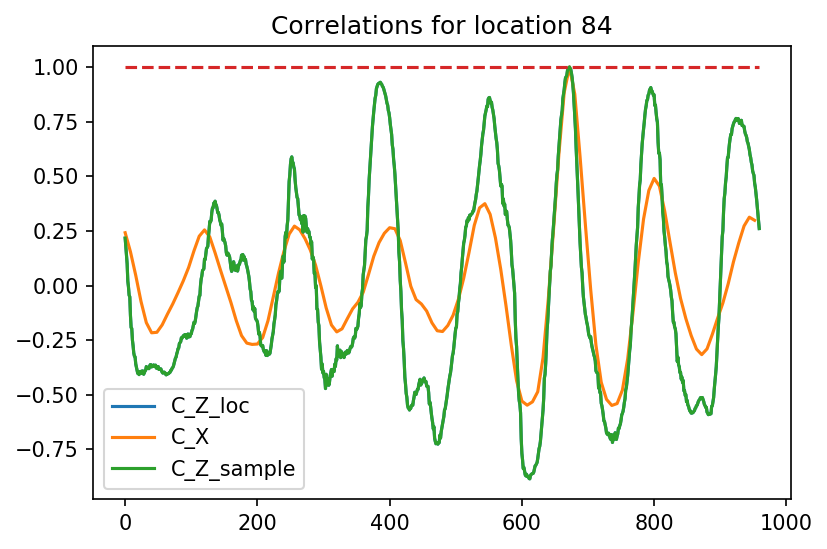

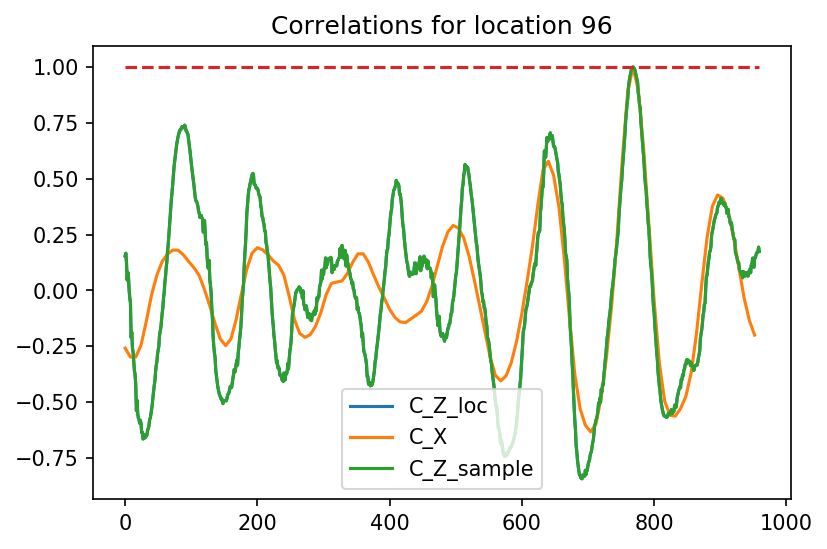

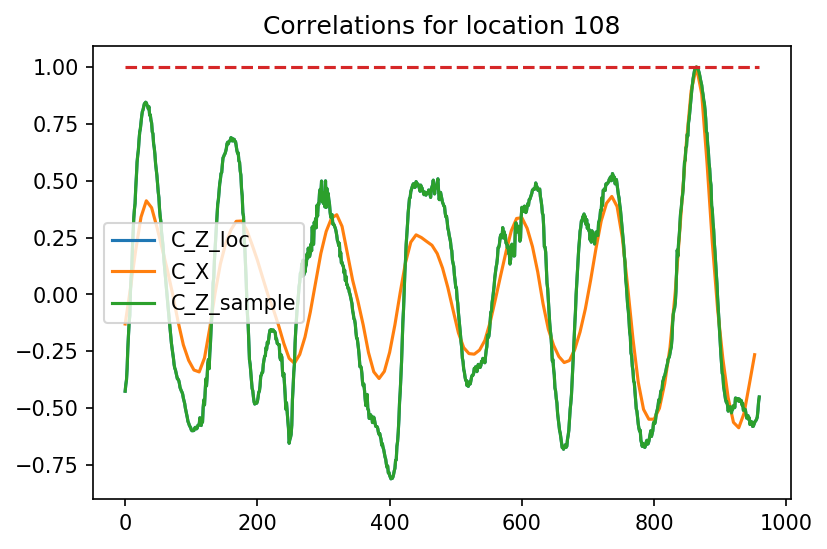

In [32]:
C_X = np.corrcoef(X0_ens)
for ii in range(10):
    iic = ii*12
    ii = iic * 8
    plt.figure(dpi=150)
    plt.plot(details['C_Z_loc'][ii])
    plt.plot(x_Xc, C_X[iic])
    plt.plot(details['C_Z_sample'][ii])
    plt.plot(np.ones(N_Z), '--')
    plt.legend(['C_Z_loc', 'C_X', 'C_Z_sample'])
    plt.title(f'Correlations for location {iic}')

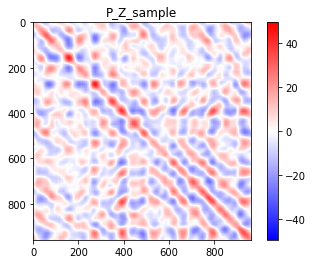

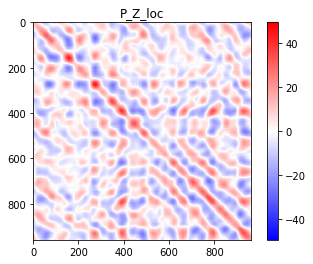

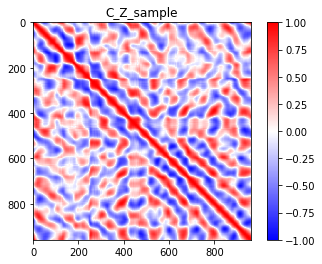

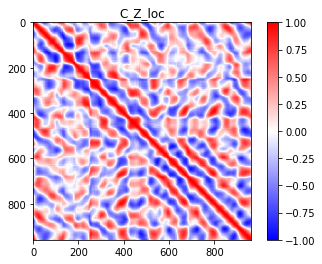

In [33]:
P_Z_sample = details['P_Z_sample']
P_Z_loc = details['P_Z_loc']

vmax = np.max([
    np.abs(P_Z_sample).max(),
    np.abs(P_Z_loc).max()])
imshow(P_Z_sample, title='P_Z_sample',
      vmax=vmax, vmin=-vmax, cmap='bwr')
imshow(P_Z_loc, title='P_Z_loc',
      vmax=vmax, vmin=-vmax, cmap='bwr')

C_Z_sample = details['C_Z_sample']
C_Z_loc = details['C_Z_loc']

vmax = np.max([
    np.abs(C_Z_sample).max(),
    np.abs(C_Z_loc).max()])
imshow(C_Z_sample, title='C_Z_sample',
      vmax=vmax, vmin=-vmax, cmap='bwr')
imshow(C_Z_loc, title='C_Z_loc',
      vmax=vmax, vmin=-vmax, cmap='bwr')

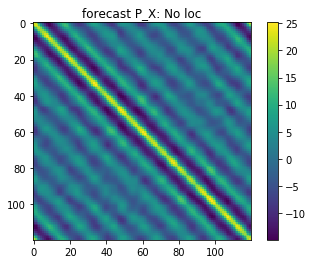

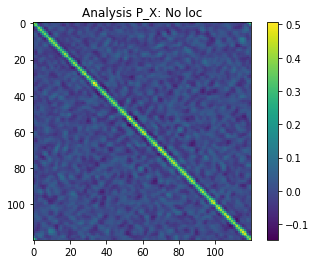

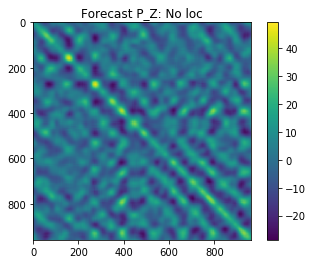

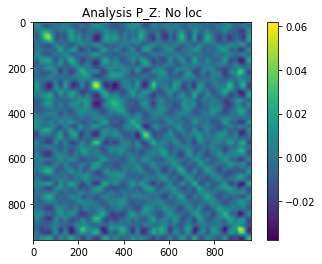

In [34]:
P_X_f = np.cov(X0_ens)
P_X_a = np.cov(X_ens_a)
P_Z_f = np.cov(Z0_ens)
P_Z_a = np.cov(Z_ens_a)

imshow(P_X_f, f'forecast P_X: {atitle}')
imshow(P_X_a, f'Analysis P_X: {atitle}')
imshow(P_Z_f, f'Forecast P_Z: {atitle}')
imshow(P_Z_a, f'Analysis P_Z: {atitle}')

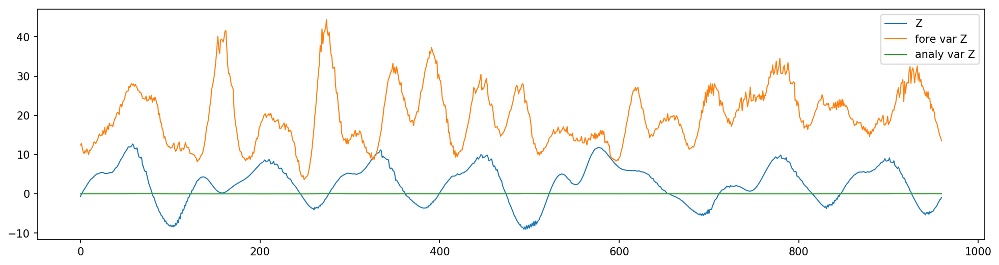

In [35]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.isel(time=0), linewidth=1)
plt.plot(np.var(Z0_ens, axis=-1), linewidth=1)
plt.plot(np.var(Z_ens_a, axis=-1), linewidth=1)
plt.legend(['Z', 'fore var Z', 'analy var Z'])

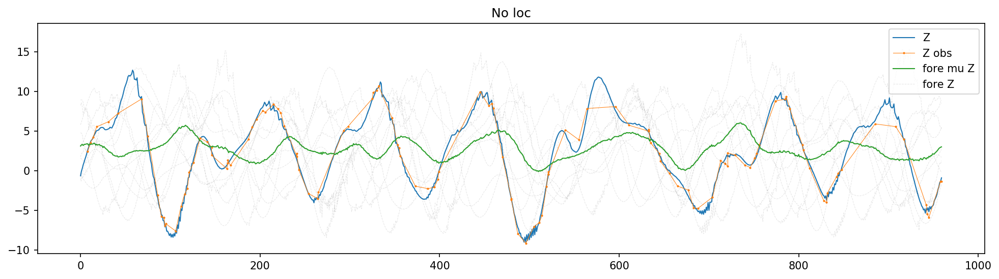

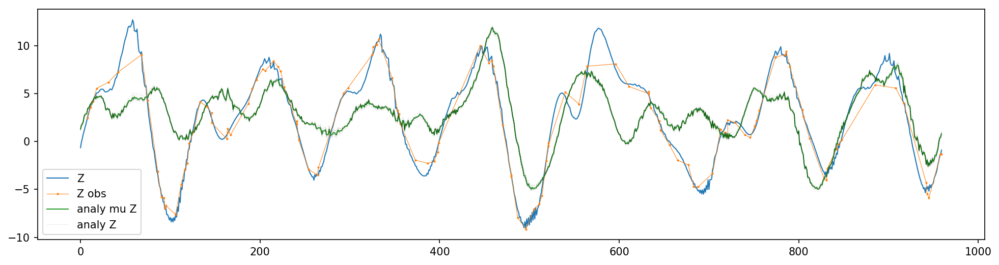

In [36]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.isel(time=0), linewidth=1)
plt.plot(Z_obs_loc, Z_obs_ts.isel(time=0), '-o', markersize=1, linewidth=0.5)
plt.plot(np.mean(Z0_ens, axis=-1), linewidth=1)
plt.plot(Z0_ens, 'k--', alpha=.1, linewidth=0.5)
plt.legend(['Z', 'Z obs', 'fore mu Z', 'fore Z'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.isel(time=0), linewidth=1)
plt.plot(Z_obs_loc, Z_obs_ts.isel(time=0), '-o', markersize=1, linewidth=0.5)
plt.plot(np.mean(Z_ens_a, axis=-1), linewidth=1)
plt.plot(Z_ens_a, 'k--', alpha=.1, linewidth=0.5)
plt.legend(['Z', 'Z obs', 'analy mu Z', 'analy Z'])

# mu = np.mean(Z_ens_a, axis=-1)
# rmse = np.sqrt(((mu - Z_GT[:, 0])**2).mean())
# plt.title(f'Z analysis with {atitle}; rmse: {rmse:0.4}')

# Standard loc

In [37]:
atitle = 'standard loc'

In [38]:
importlib.reload(assimilate)
importlib.reload(utilities)

# rho0_Zf = 5
# rho_Zf = np.arange(N_Z)
# rho_Zf = np.minimum(np.abs(N_Z - rho_Zf)%N_Z, rho_Zf)
# rho_Zf = np.exp(-(rho_Zf**2)/(2*rho0_Zf**2))
# rho_Zf = sp.linalg.circulant(rho_Zf)
# # imshow(rho_Zf, 'rho Zf',
# #        vmin=0, vmax=1)
# # imshow(rho_Zf[:20, :20], 'rho Zf zoom',
# #        vmin=0, vmax=1)

rho0_Zc = 100
rho_Zc = np.arange(N_Z)
rho_Zc = np.minimum(np.abs(N_Z - rho_Zc)%N_Z, rho_Zc)
rho_Zc = np.exp(-(rho_Zc**2)/(2*rho0_Zc**2))
rho_Zc = sp.linalg.circulant(rho_Zc)
# imshow(rho_Zc, 'rho Zc',
#        vmin=0, vmax=1)
# rho_Zc = None



# assim_type = 'SVD_loc'
assim_type = 'standard loc'
return_details = True
X_ens_a, Z_ens_a, details = assimilate.dual_scale_enkf(
    X_ens=X0_ens, X_obs=X_obs_ts.isel(time=0).values, H_X=H_Xc, R_X=R_Xc,
    Z_ens=Z0_ens, Z_obs=Z_obs_ts.isel(time=0).values, H_Z=H_Z, R_Z=R_Z,
    H_sub=H_sub, R_sub=R_sub, coarse=coarse,
    rho_Zc=rho_Zc,
    assim_type=assim_type, return_details=return_details)

In [39]:
%matplotlib inline

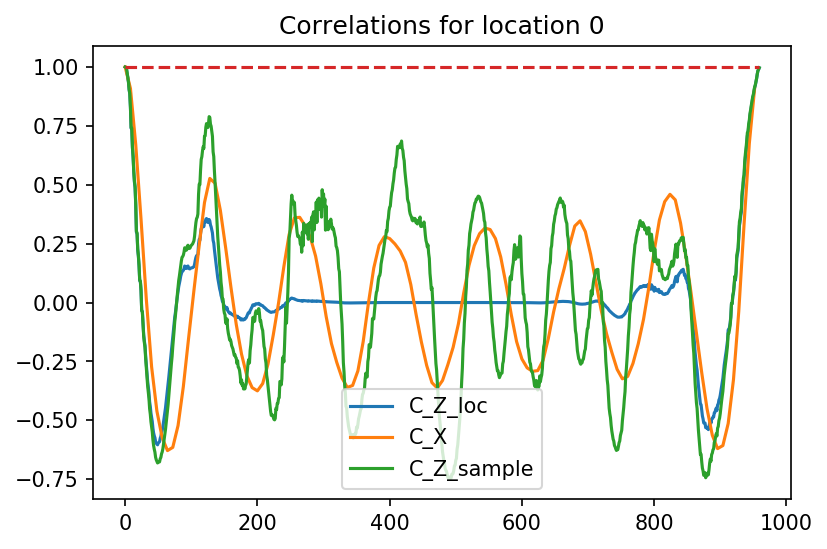

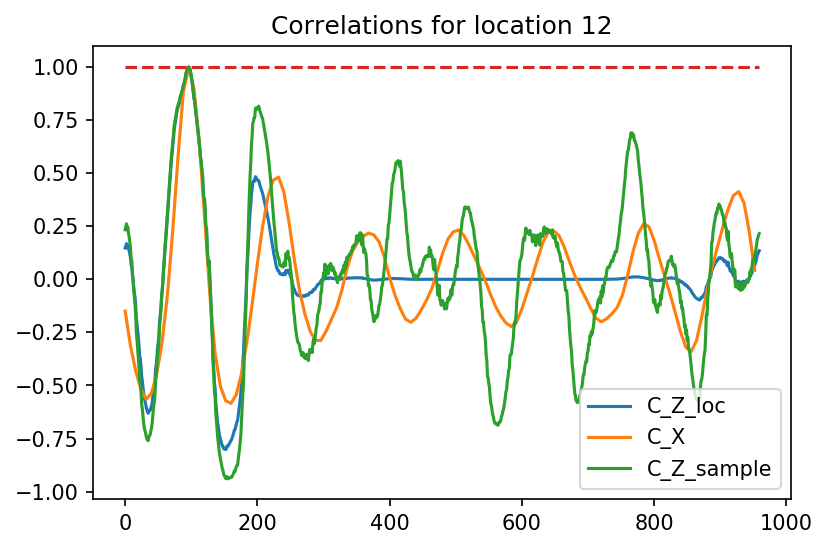

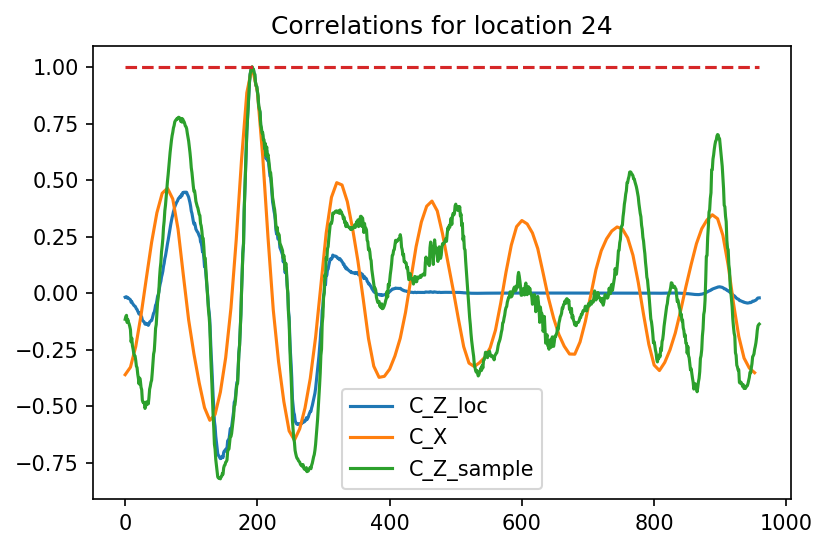

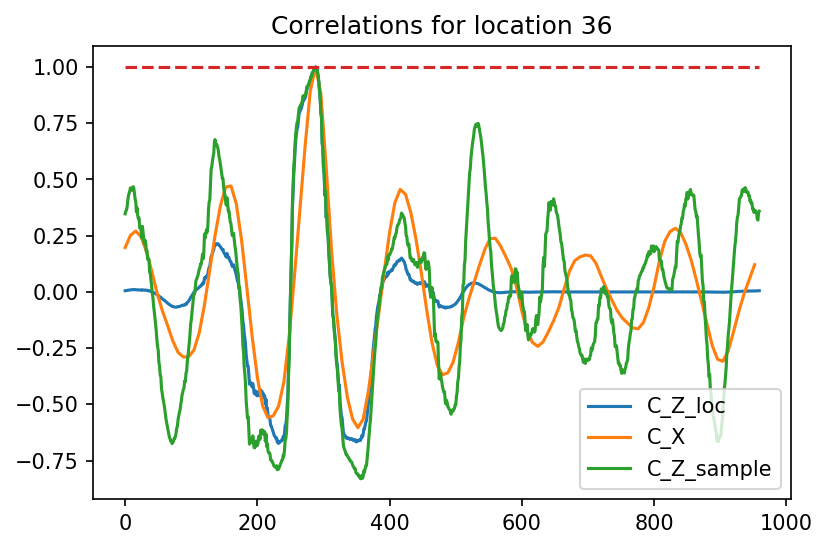

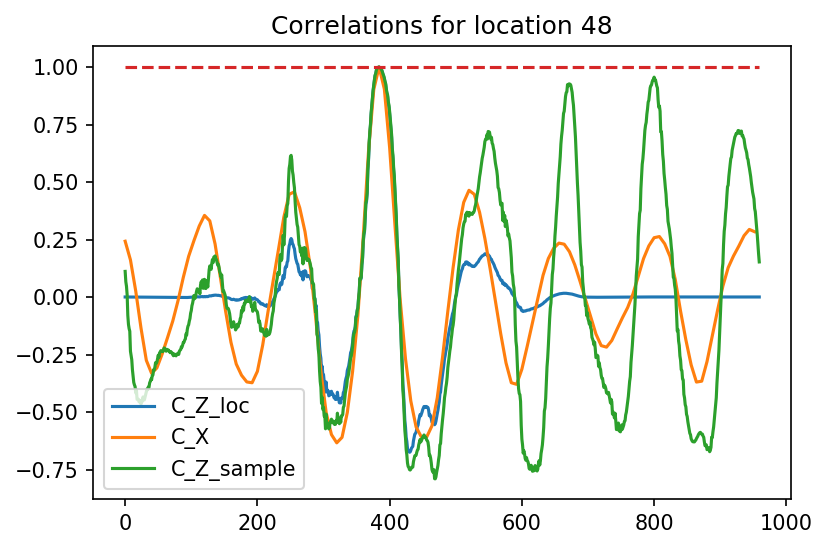

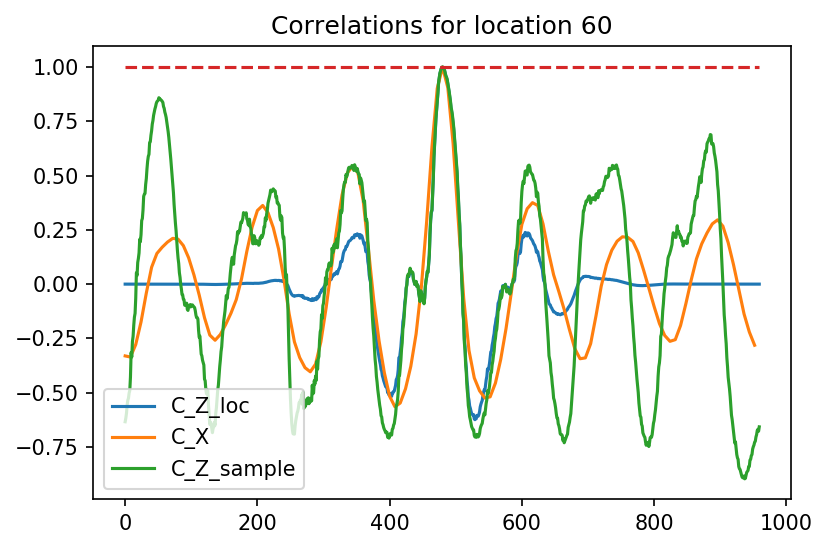

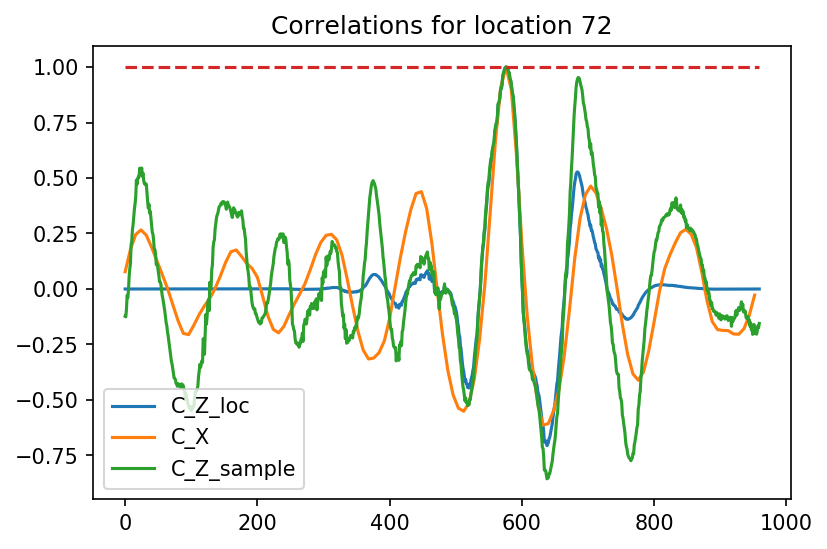

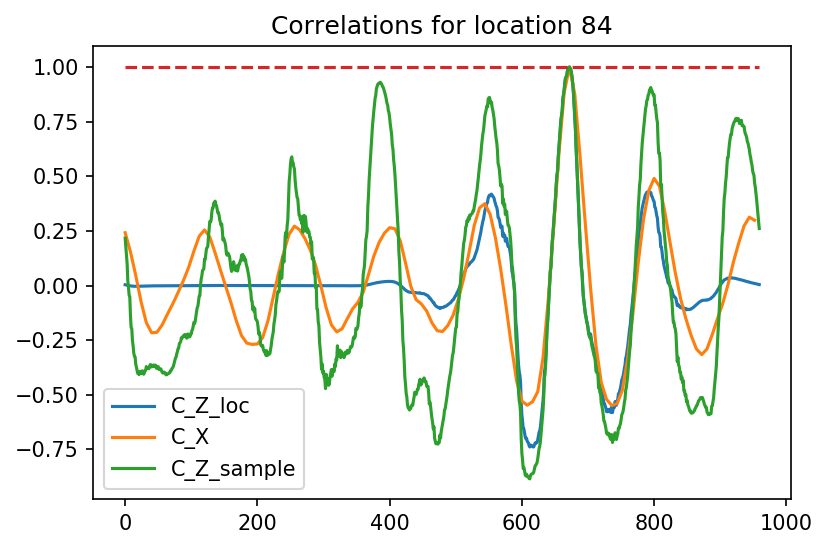

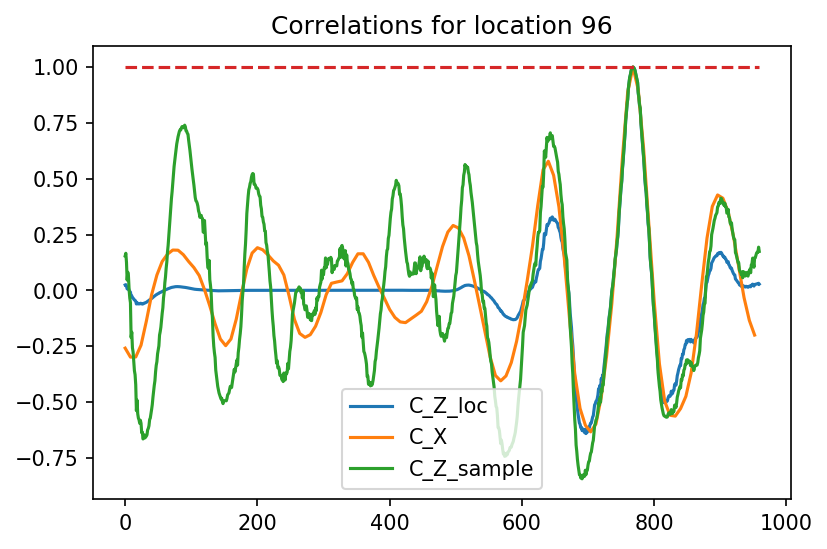

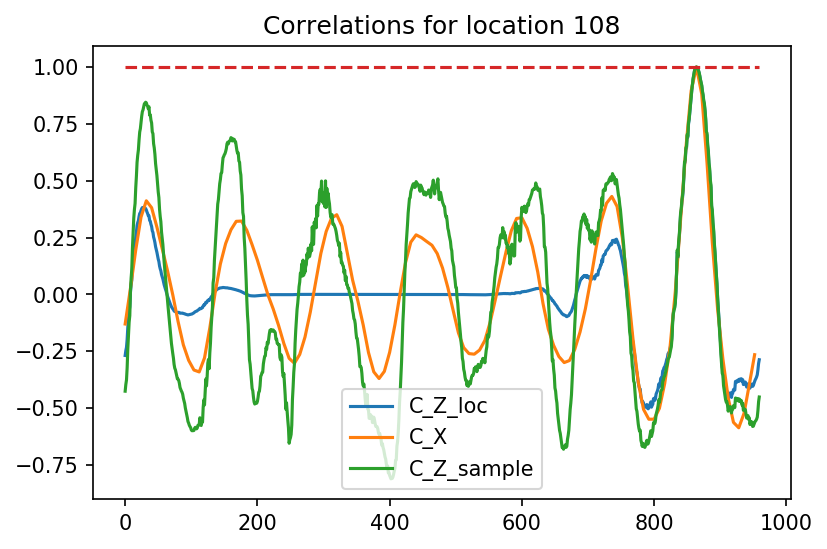

In [40]:
C_X = np.corrcoef(X0_ens)
for ii in range(10):
    iic = ii*12
    ii = iic * 8
    plt.figure(dpi=150)
    plt.plot(details['C_Z_loc'][ii])
    plt.plot(x_Xc, C_X[iic])
    plt.plot(details['C_Z_sample'][ii])
    plt.plot(np.ones(N_Z), '--')
    plt.legend(['C_Z_loc', 'C_X', 'C_Z_sample'])
    plt.title(f'Correlations for location {iic}')

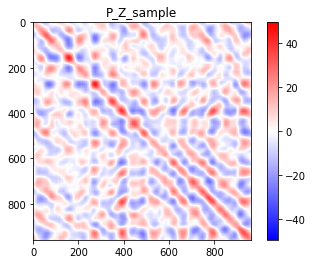

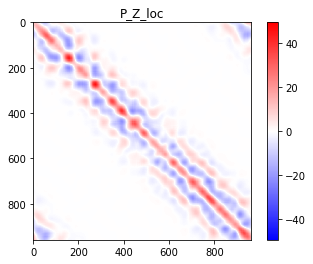

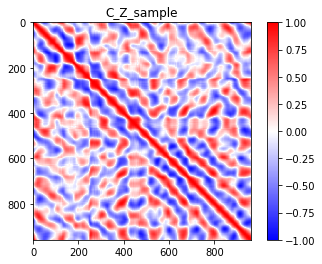

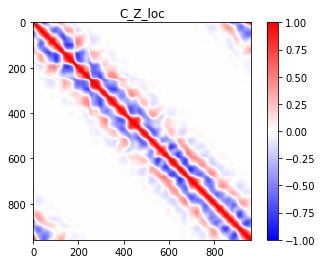

In [41]:
P_Z_sample = details['P_Z_sample']
P_Z_loc = details['P_Z_loc']

vmax = np.max([
    np.abs(P_Z_sample).max(),
    np.abs(P_Z_loc).max()])
imshow(P_Z_sample, title='P_Z_sample',
      vmax=vmax, vmin=-vmax, cmap='bwr')
imshow(P_Z_loc, title='P_Z_loc',
      vmax=vmax, vmin=-vmax, cmap='bwr')

C_Z_sample = details['C_Z_sample']
C_Z_loc = details['C_Z_loc']

vmax = np.max([
    np.abs(C_Z_sample).max(),
    np.abs(C_Z_loc).max()])
imshow(C_Z_sample, title='C_Z_sample',
      vmax=vmax, vmin=-vmax, cmap='bwr')
imshow(C_Z_loc, title='C_Z_loc',
      vmax=vmax, vmin=-vmax, cmap='bwr')

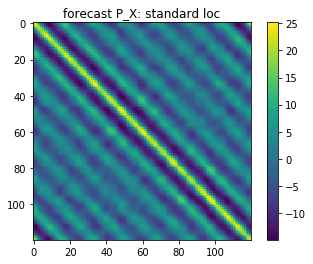

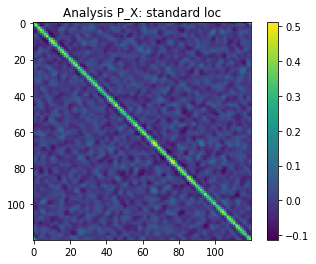

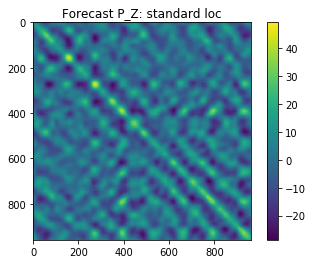

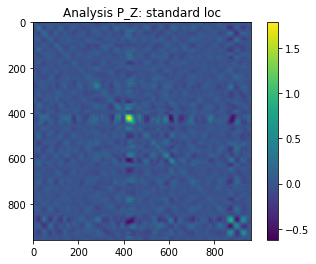

In [42]:
P_X_f = np.cov(X0_ens)
P_X_a = np.cov(X_ens_a)
P_Z_f = np.cov(Z0_ens)
P_Z_a = np.cov(Z_ens_a)

imshow(P_X_f, f'forecast P_X: {atitle}')
imshow(P_X_a, f'Analysis P_X: {atitle}')
imshow(P_Z_f, f'Forecast P_Z: {atitle}')
imshow(P_Z_a, f'Analysis P_Z: {atitle}')

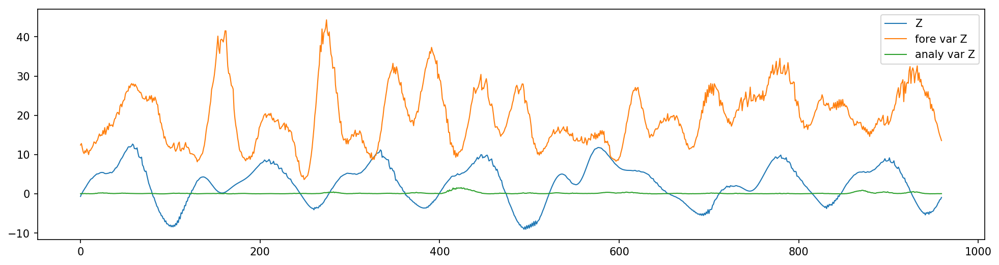

In [43]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.isel(time=0), linewidth=1)
plt.plot(np.var(Z0_ens, axis=-1), linewidth=1)
plt.plot(np.var(Z_ens_a, axis=-1), linewidth=1)
plt.legend(['Z', 'fore var Z', 'analy var Z'])

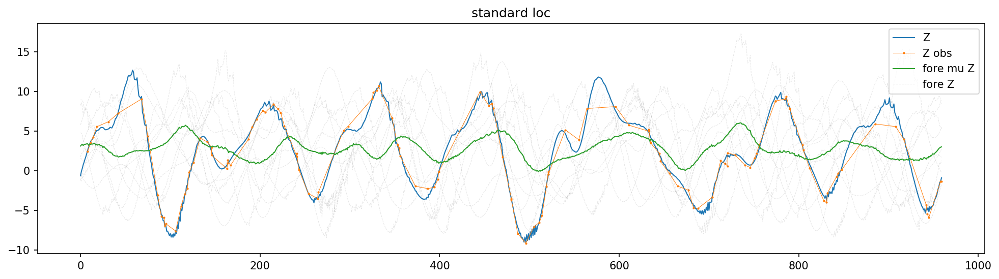

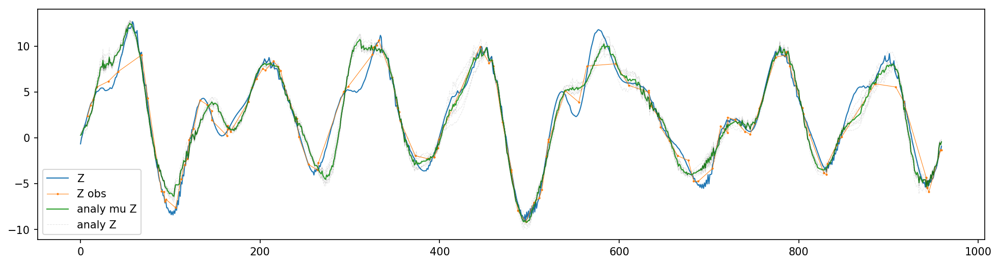

In [44]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.isel(time=0), linewidth=1)
plt.plot(Z_obs_loc, Z_obs_ts.isel(time=0), '-o', markersize=1, linewidth=0.5)
plt.plot(np.mean(Z0_ens, axis=-1), linewidth=1)
plt.plot(Z0_ens, 'k--', alpha=.1, linewidth=0.5)
plt.legend(['Z', 'Z obs', 'fore mu Z', 'fore Z'])
plt.title(atitle)


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.isel(time=0), linewidth=1)
plt.plot(Z_obs_loc, Z_obs_ts.isel(time=0), '-o', markersize=1, linewidth=0.5)
plt.plot(np.mean(Z_ens_a, axis=-1), linewidth=1)
plt.plot(Z_ens_a, 'k--', alpha=.1, linewidth=0.5)
plt.legend(['Z', 'Z obs', 'analy mu Z', 'analy Z'])

# mu = np.mean(Z_ens_a, axis=-1)
# rmse = np.sqrt(((mu - Z_GT[:, 0])**2).mean())
# plt.title(f'Z analysis with {atitle}; rmse: {rmse:0.4}')

# SVD localization

In [45]:
atitle = 'SVD loc'

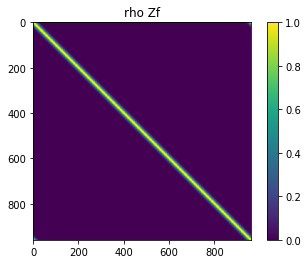

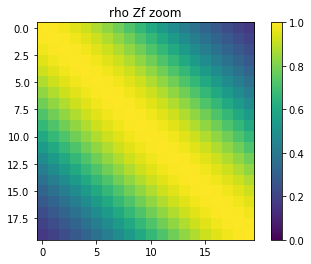

In [46]:
importlib.reload(assimilate)
importlib.reload(utilities)

rho0_Zf = 10
rho_Zf = np.arange(N_Z)
rho_Zf = np.minimum(np.abs(N_Z - rho_Zf)%N_Z, rho_Zf)
rho_Zf = np.exp(-(rho_Zf**2)/(2*rho0_Zf**2))
rho_Zf = sp.linalg.circulant(rho_Zf)
imshow(rho_Zf, 'rho Zf',
       vmin=0, vmax=1)
imshow(rho_Zf[:20, :20], 'rho Zf zoom',
       vmin=0, vmax=1)

# rho0_Zc = 300
# rho_Zc = np.arange(N_Z)
# rho_Zc = np.minimum(np.abs(N_Z - rho_Zc)%N_Z, rho_Zc)
# rho_Zc = np.exp(-(rho_Zc**2)/(2*rho0_Zc**2))
# rho_Zc = sp.linalg.circulant(rho_Zc)
# imshow(rho_Zc, 'rho Zc',
#        vmin=0, vmax=1)
rho_Zc = None



assim_type = 'SVD_loc'
# assim_type = 'standard loc'
return_details = True
use_sample_var = True
sig_fraction = 1
max_cond = 50
X_ens_a, Z_ens_a, details = assimilate.dual_scale_enkf(
    X_ens=X0_ens, X_obs=X_obs_ts.isel(time=0).values, H_X=H_Xc, R_X=R_Xc,
    Z_ens=Z0_ens, Z_obs=Z_obs_ts.isel(time=0).values, H_Z=H_Z, R_Z=R_Z,
    H_sub=H_sub, R_sub=R_sub, coarse=coarse, rho_Zf=rho_Zf,
    rho_Zc=rho_Zc,
    sig_fraction=sig_fraction,
    assim_type=assim_type, return_details=return_details,
    use_sample_var=use_sample_var,
    max_cond=max_cond)

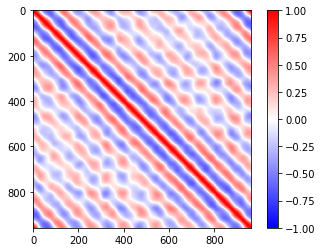

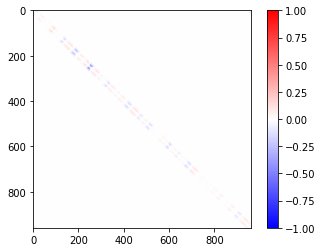

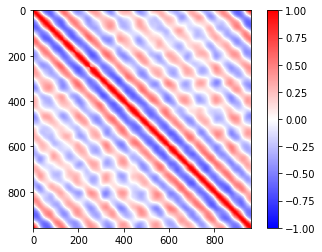

In [47]:
imshow(details['C_Z_ll'], vmax=1, vmin=-1, cmap='bwr')

imshow(details['C_Z_orth'], vmax=1, vmin=-1, cmap='bwr')
imshow(details['C_Z_loc'], vmax=1, vmin=-1, cmap='bwr')

In [48]:
%matplotlib inline

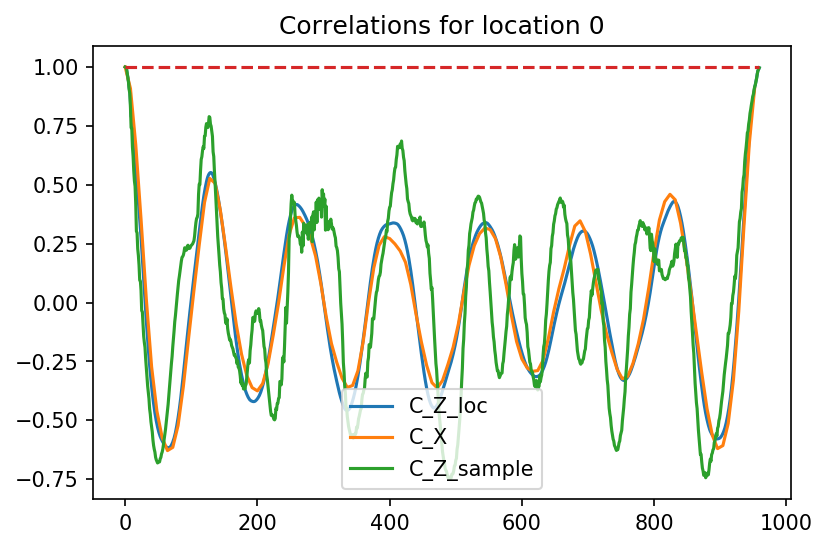

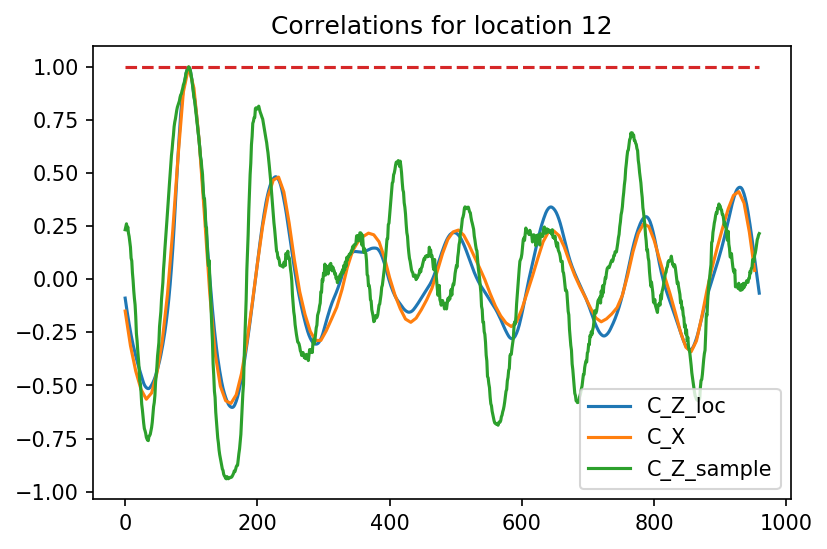

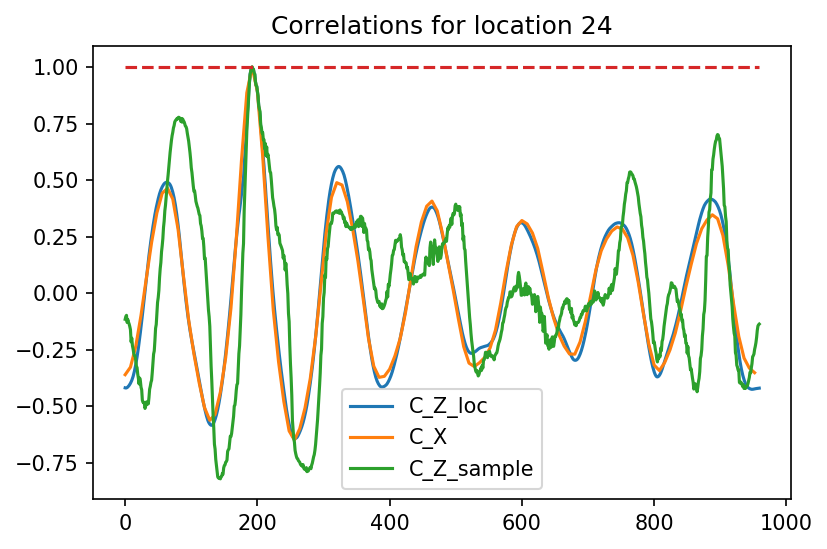

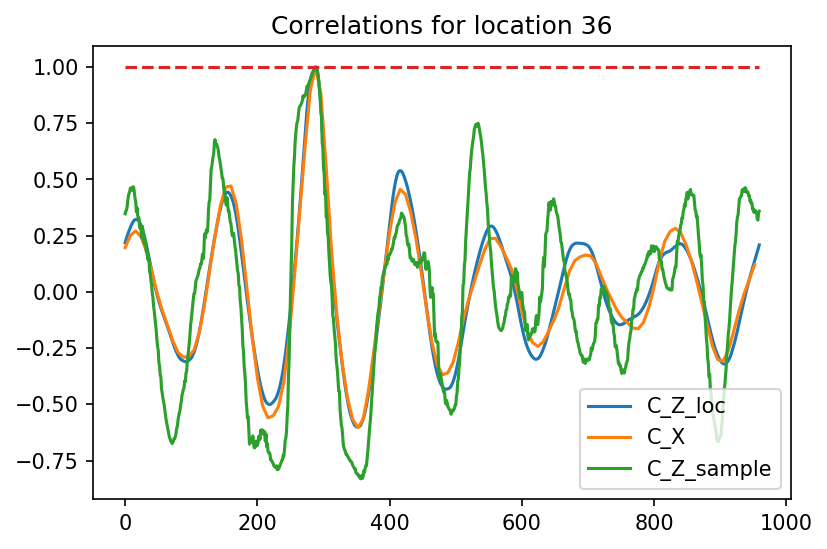

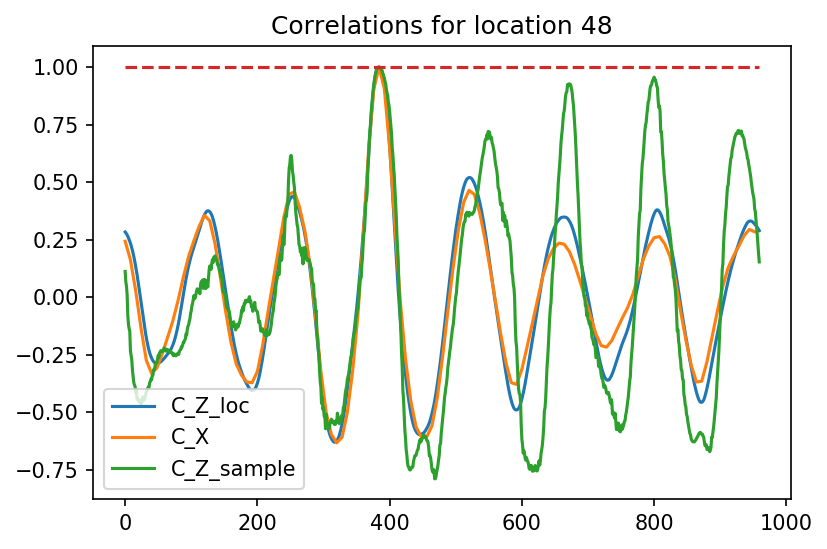

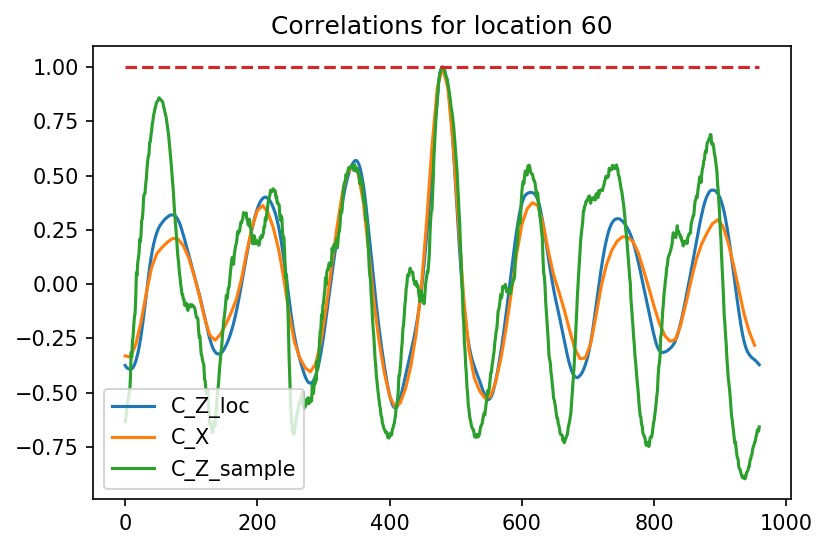

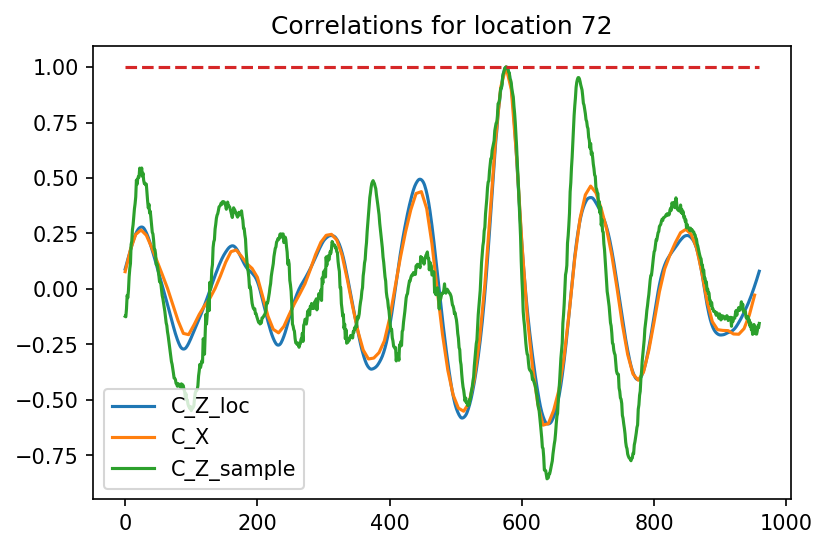

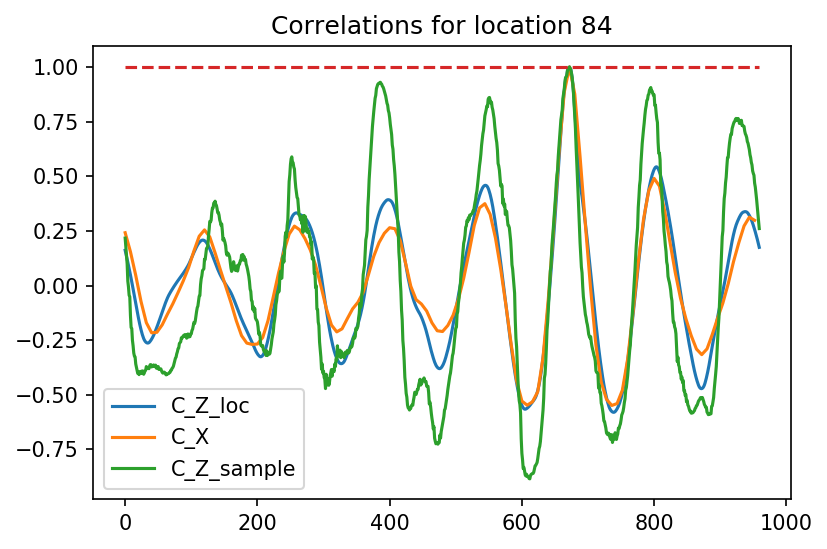

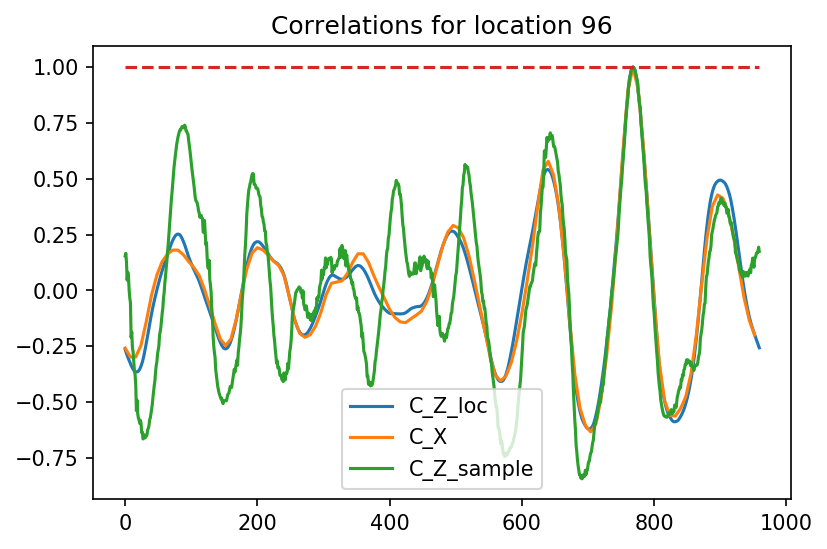

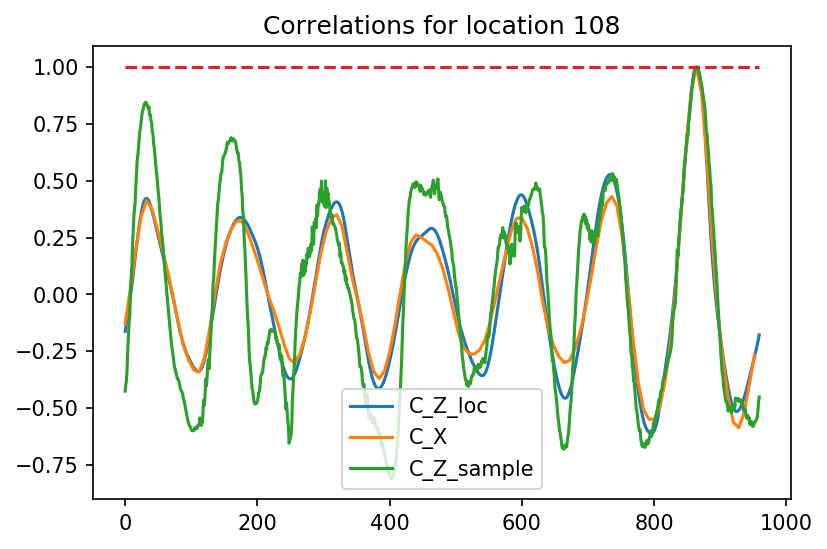

In [49]:
C_X = np.corrcoef(X0_ens)
for ii in range(10):
    iic = ii*12
    ii = iic * 8
    plt.figure(dpi=150)
    plt.plot(details['C_Z_loc'][ii])
    plt.plot(x_Xc, C_X[iic])
    plt.plot(details['C_Z_sample'][ii])
    plt.plot(np.ones(N_Z), '--')
    plt.legend(['C_Z_loc', 'C_X', 'C_Z_sample'])
    plt.title(f'Correlations for location {iic}')

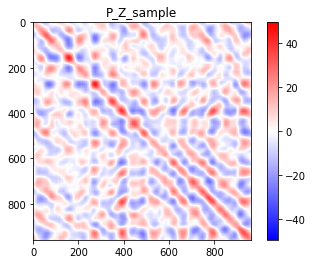

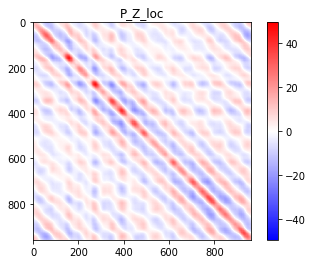

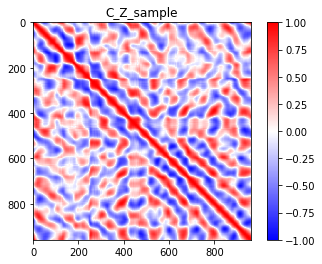

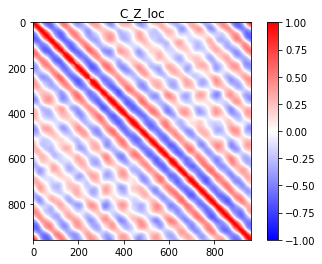

In [50]:
P_Z_sample = details['P_Z_sample']
P_Z_loc = details['P_Z_loc']

vmax = np.max([
    np.abs(P_Z_sample).max(),
    np.abs(P_Z_loc).max()])
imshow(P_Z_sample, title='P_Z_sample',
      vmax=vmax, vmin=-vmax, cmap='bwr')
imshow(P_Z_loc, title='P_Z_loc',
      vmax=vmax, vmin=-vmax, cmap='bwr')

C_Z_sample = details['C_Z_sample']
C_Z_loc = details['C_Z_loc']

vmax = np.max([
    np.abs(C_Z_sample).max(),
    np.abs(C_Z_loc).max()])
imshow(C_Z_sample, title='C_Z_sample',
      vmax=vmax, vmin=-vmax, cmap='bwr')
imshow(C_Z_loc, title='C_Z_loc',
      vmax=vmax, vmin=-vmax, cmap='bwr')

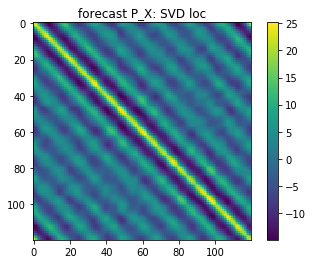

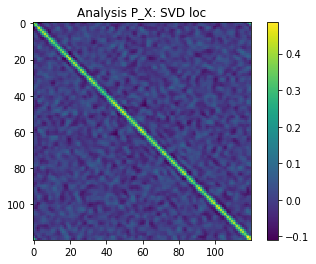

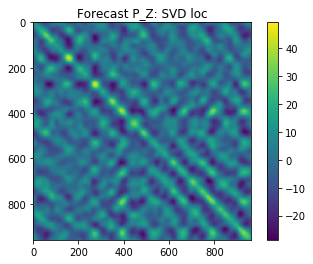

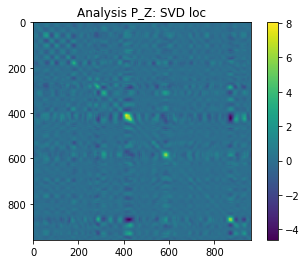

In [51]:
P_X_f = np.cov(X0_ens)
P_X_a = np.cov(X_ens_a)
P_Z_f = np.cov(Z0_ens)
P_Z_a = np.cov(Z_ens_a)

imshow(P_X_f, f'forecast P_X: {atitle}')
imshow(P_X_a, f'Analysis P_X: {atitle}')
imshow(P_Z_f, f'Forecast P_Z: {atitle}')
imshow(P_Z_a, f'Analysis P_Z: {atitle}')

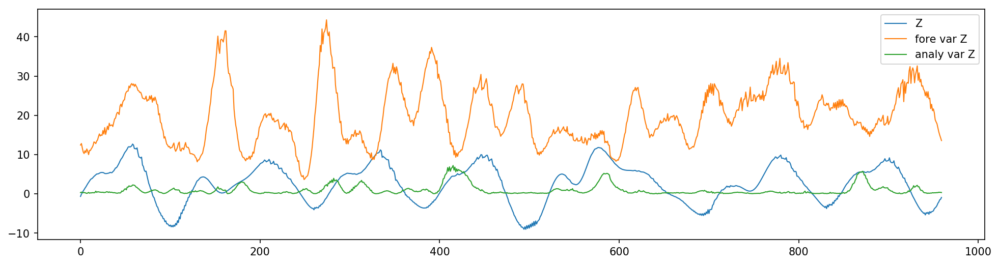

In [52]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.isel(time=0), linewidth=1)
plt.plot(np.var(Z0_ens, axis=-1), linewidth=1)
plt.plot(np.var(Z_ens_a, axis=-1), linewidth=1)
plt.legend(['Z', 'fore var Z', 'analy var Z'])

Text(0.5, 1.0, 'Analysis with SVD loc')

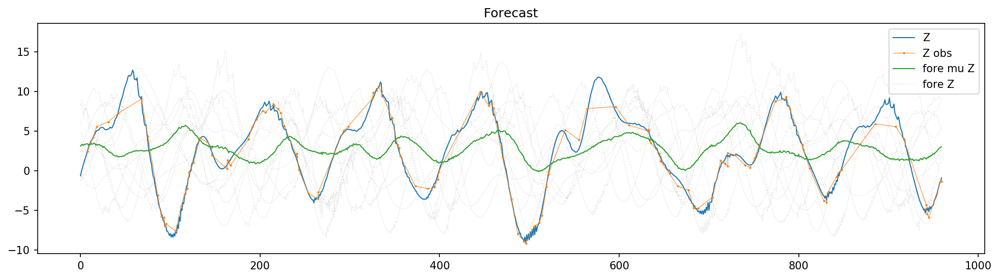

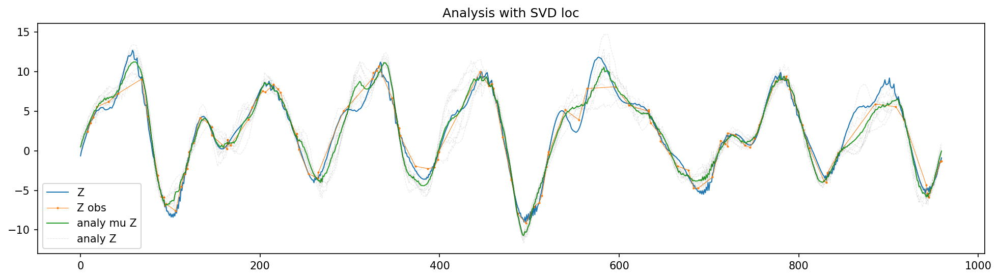

In [53]:
figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.isel(time=0), linewidth=1)
plt.plot(Z_obs_loc, Z_obs_ts.isel(time=0), '-o', markersize=1, linewidth=0.5)
plt.plot(np.mean(Z0_ens, axis=-1), linewidth=1)
plt.plot(Z0_ens, 'k--', alpha=.1, linewidth=0.5)
plt.legend(['Z', 'Z obs', 'fore mu Z', 'fore Z'])
plt.title('Forecast')


figsize = plt.figaspect(1/4)
plt.figure(dpi=150, figsize=figsize)
plt.plot(Z_ts.isel(time=0), linewidth=1)
plt.plot(Z_obs_loc, Z_obs_ts.isel(time=0), '-o', markersize=1, linewidth=0.5)
plt.plot(np.mean(Z_ens_a, axis=-1), linewidth=1)
plt.plot(Z_ens_a, 'k--', alpha=.1, linewidth=0.5)
plt.legend(['Z', 'Z obs', 'analy mu Z', 'analy Z'])
plt.title(f'Analysis with {atitle}')

# mu = np.mean(Z_ens_a, axis=-1)
# rmse = np.sqrt(((mu - Z_GT[:, 0])**2).mean())
# plt.title(f'Z analysis with {atitle}; rmse: {rmse:0.4}')

# Cycle

# Cycle with no localization

In [54]:
atitle='no loc'

In [55]:
# rho0_Zf = 5
# rho_Zf = np.arange(N_Z)
# rho_Zf = np.minimum(np.abs(N_Z - rho_Zf)%N_Z, rho_Zf)
# rho_Zf = np.exp(-(rho_Zf**2)/(2*rho0_Zf**2))
# rho_Zf = sp.linalg.circulant(rho_Zf)
# imshow(rho_Zf, 'rho Zf',
#        vmin=0, vmax=1)
# imshow(rho_Zf[:20, :20], 'rho Zf zoom',
#        vmin=0, vmax=1)

# rho0_Zc = 100
# rho_Zc = np.arange(N_Z)
# rho_Zc = np.minimum(np.abs(N_Z - rho_Zc)%N_Z, rho_Zc)
# rho_Zc = np.exp(-(rho_Zc**2)/(2*rho0_Zc**2))
# rho_Zc = sp.linalg.circulant(rho_Zc)
# imshow(rho_Zc, 'rho Zc',
#        vmin=0, vmax=1)

rho_Zc = None

cycle_dict = {'X0_ens': X0_ens, 'Z0_ens': Z0_ens,
              'X_obs_ts': X_obs_ts, 'Z_obs_ts': Z_obs_ts,
              'R_X': R_Xc, 'R_Z': R_Z,
              'H_X': H_Xc, 'H_Z': H_Z,
              'dt': dt,
              'coarse': coarse,
              'rho_Zc': rho_Zc,
              'H_sub': H_sub,
              'R_sub': R_sub,
              'assim_type': 'standard loc'}

In [56]:
importlib.reload(assimilate)
importlib.reload(utilities)

X_ens_ts, Z_ens_ts = assimilate.cycle_KF_LM3(**cycle_dict)

0.0
assimed
pushed Z
pushed X
0.1
assimed
pushed Z
pushed X
0.2
assimed
pushed Z
pushed X
0.3
assimed
pushed Z
pushed X
0.4
assimed
pushed Z
pushed X
0.5
assimed
pushed Z
pushed X
0.6
assimed
pushed Z
pushed X
0.7
assimed
pushed Z
pushed X
0.8
assimed
pushed Z
pushed X
0.9
assimed
pushed Z
pushed X
1.0
assimed
pushed Z
pushed X
1.1
assimed
pushed Z
pushed X
1.2
assimed
pushed Z
pushed X
1.3
assimed
pushed Z
pushed X
1.4
assimed
pushed Z
pushed X
1.5
assimed
pushed Z
pushed X
1.6
assimed
pushed Z
pushed X
1.7
assimed
pushed Z
pushed X
1.8
assimed
pushed Z
pushed X
1.9
assimed
pushed Z
pushed X
2.0
assimed
pushed Z
pushed X
2.1
assimed
pushed Z
pushed X
2.2
assimed
pushed Z
pushed X
2.3
assimed
pushed Z
pushed X
2.4
assimed
pushed Z
pushed X
2.5
assimed
pushed Z
pushed X
2.6
assimed
pushed Z
pushed X
2.7
assimed
pushed Z
pushed X
2.8
assimed
pushed Z
pushed X
2.9
assimed
pushed Z
pushed X
3.0
assimed
pushed Z
pushed X
3.1
assimed
pushed Z
pushed X
3.2
assimed
pushed Z
pushed X
3.3
assime

pushed X
26.8
assimed
pushed Z
pushed X
26.9
assimed
pushed Z
pushed X
27.0
assimed
pushed Z
pushed X
27.1
assimed
pushed Z
pushed X
27.2
assimed
pushed Z
pushed X
27.3
assimed
pushed Z
pushed X
27.4
assimed
pushed Z
pushed X
27.5
assimed
pushed Z
pushed X
27.6
assimed
pushed Z
pushed X
27.7
assimed
pushed Z
pushed X
27.8
assimed
pushed Z
pushed X
27.9
assimed
pushed Z
pushed X
28.0
assimed
pushed Z
pushed X
28.1
assimed
pushed Z
pushed X
28.2
assimed
pushed Z
pushed X
28.3
assimed
pushed Z
pushed X
28.4
assimed
pushed Z
pushed X
28.5
assimed
pushed Z
pushed X
28.6
assimed
pushed Z
pushed X
28.7
assimed
pushed Z
pushed X
28.8
assimed
pushed Z
pushed X
28.9
assimed
pushed Z
pushed X
29.0
assimed
pushed Z
pushed X
29.1
assimed
pushed Z
pushed X
29.2
assimed
pushed Z
pushed X
29.3
assimed
pushed Z
pushed X
29.4
assimed
pushed Z
pushed X
29.5
assimed
pushed Z
pushed X
29.6
assimed
pushed Z
pushed X
29.7
assimed
pushed Z
pushed X
29.8
assimed
pushed Z
pushed X
29.9
assimed
pushed Z
pushed X

In [57]:
Zf_ens_ts = [da.isel(time=slice(1, None)) for da in Z_ens_ts]
Zf_ens_ts = xr.concat(Zf_ens_ts, dim='time')
temp = xr.DataArray(
    data=Z0_ens[:, :, None],
    dims=Zf_ens_ts.dims,
    coords={'loc': Zf_ens_ts['loc'].values,
            'ens_num': Zf_ens_ts['ens_num'].values,
            'time': [0]})
Zf_ens_ts = xr.concat([temp, Zf_ens_ts], dim='time')
Zf_ens_ts['time'] = np.round(Zf_ens_ts.time.values, 3)

In [58]:
Za_ens_ts = [da.isel(time=slice(None, -1)) for da in Z_ens_ts]
Za_ens_ts = xr.concat(Za_ens_ts, dim='time')
Za_ens_ts['time'] = np.round(Za_ens_ts.time.values, 3)

In [59]:
Xf_ens_ts = [da.isel(time=slice(1, None)) for da in X_ens_ts]
Xf_ens_ts = xr.concat(Xf_ens_ts, dim='time')
temp = xr.DataArray(
    data=X0_ens[:, :, None],
    dims=Xf_ens_ts.dims,
    coords={'loc': Xf_ens_ts['loc'].values,
            'ens_num': Xf_ens_ts['ens_num'].values,
            'time': [0]})
Xf_ens_ts = xr.concat([temp, Xf_ens_ts], dim='time')
Xf_ens_ts['time'] = np.round(Xf_ens_ts.time.values, 3)

In [60]:
Xa_ens_ts = [da.isel(time=slice(None, -1)) for da in X_ens_ts]
Xa_ens_ts = xr.concat(Xa_ens_ts, dim='time')
Xa_ens_ts['time'] = np.round(Xa_ens_ts.time.values, 3)

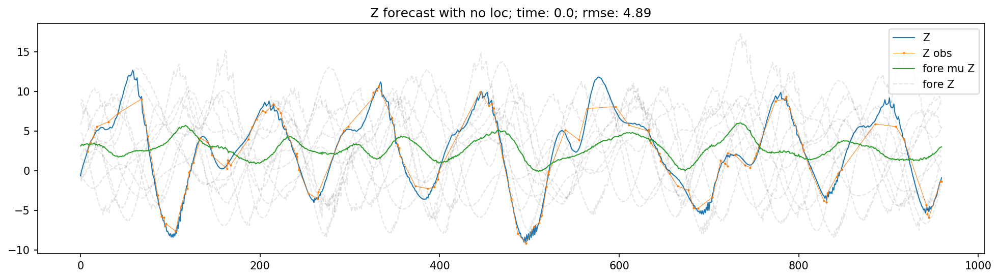

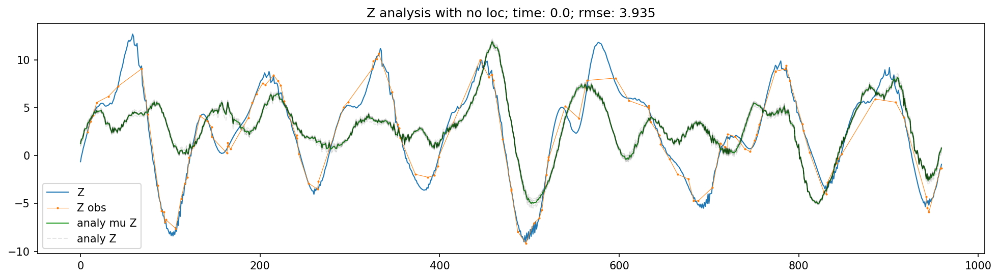

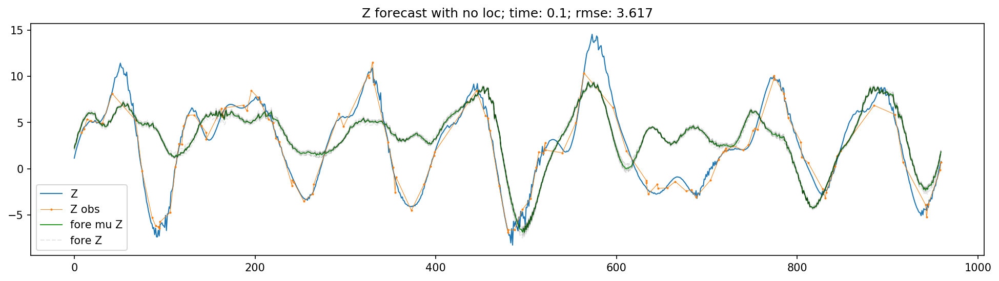

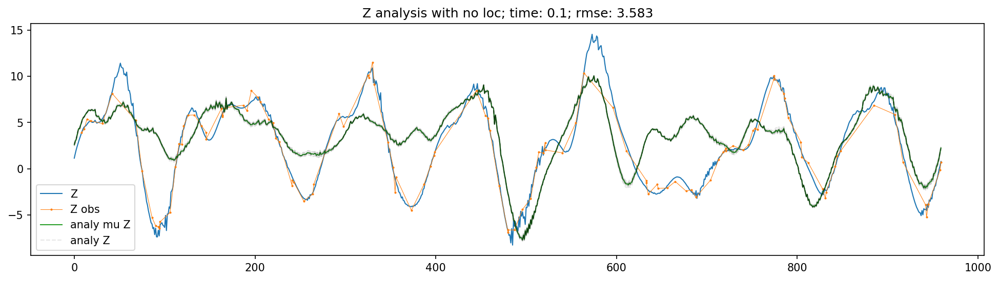

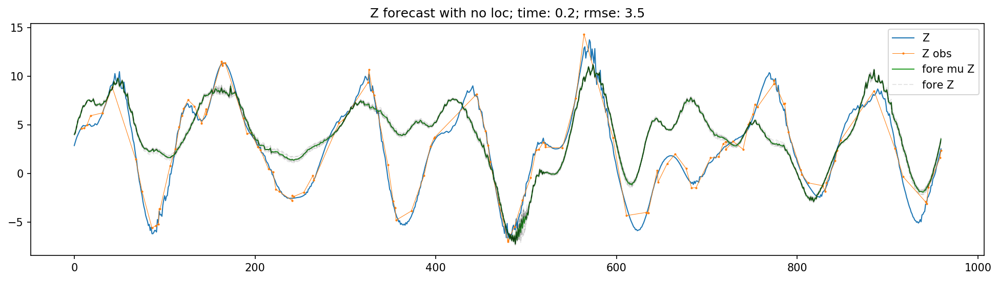

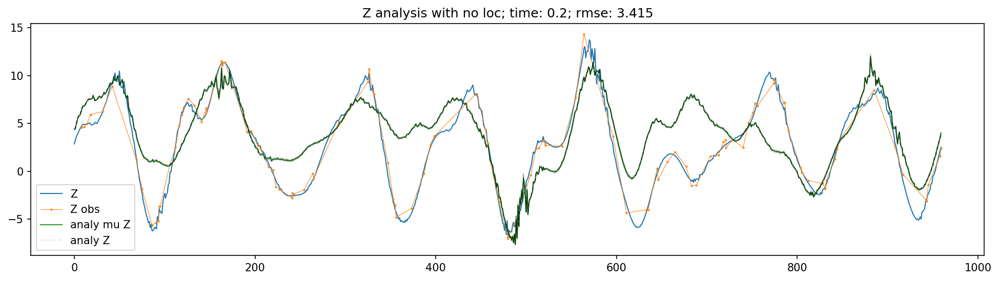

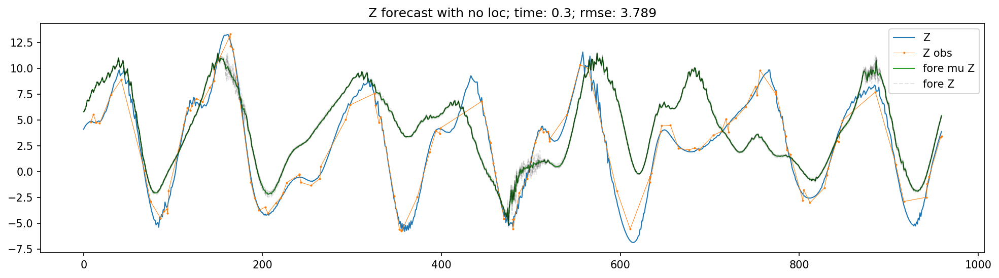

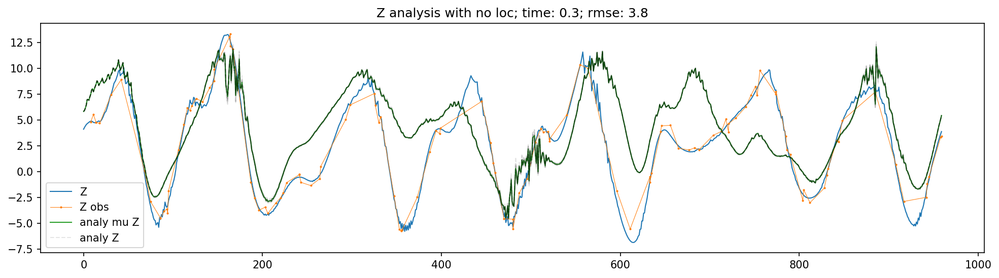

In [61]:
# times_to_see = 2 * np.arange(5, dtype=float)
times_to_see = t_obs[:4]
for this_time in times_to_see:
    
    this_ens = Zf_ens_ts.sel(time=this_time)
    
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_ts.sel(time=this_time), linewidth=1)
    plt.plot(Z_obs_loc, Z_obs_ts.sel(time=this_time), '-o', markersize=1, linewidth=0.5)
    plt.plot(this_ens.mean(dim='ens_num'), linewidth=1)
    plt.plot(this_ens, 'k--', alpha=.1, linewidth=1)
    plt.legend(['Z', 'Z obs', 'fore mu Z', 'fore Z'])

    mu = this_ens.mean(dim='ens_num')
    rmse = np.sqrt(((mu.values - Z_ts.sel(time=this_time).values)**2).mean())
    plt.title(f'Z forecast with {atitle}; time: {this_time:0.2}; rmse: {rmse:0.4}')


    this_ens = Za_ens_ts.sel(time=this_time)

    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_ts.sel(time=this_time), linewidth=1)
    plt.plot(Z_obs_loc, Z_obs_ts.sel(time=this_time), '-o', markersize=1, linewidth=0.5)
    plt.plot(this_ens.mean(dim='ens_num'), linewidth=1)
    plt.plot(this_ens, 'k--', alpha=.1, linewidth=1)
    plt.legend(['Z', 'Z obs', 'analy mu Z', 'analy Z'])

    mu = this_ens.mean(dim='ens_num')
    rmse = np.sqrt(((mu.values - Z_ts.sel(time=this_time).values)**2).mean())
    plt.title(f'Z analysis with {atitle}; time: {this_time:0.2}; rmse: {rmse:0.4}')

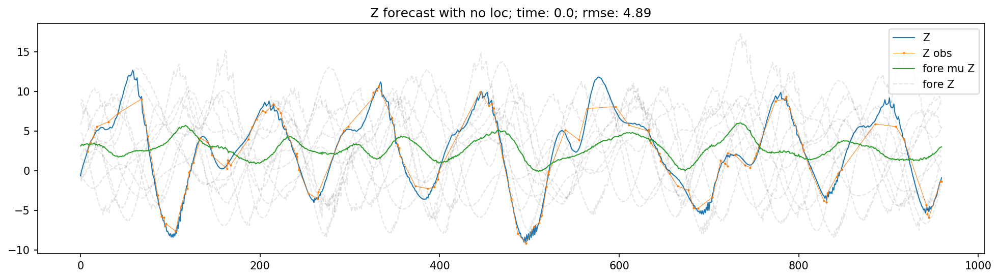

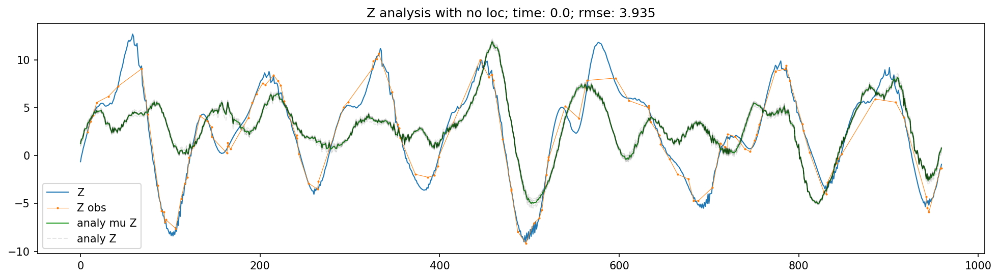

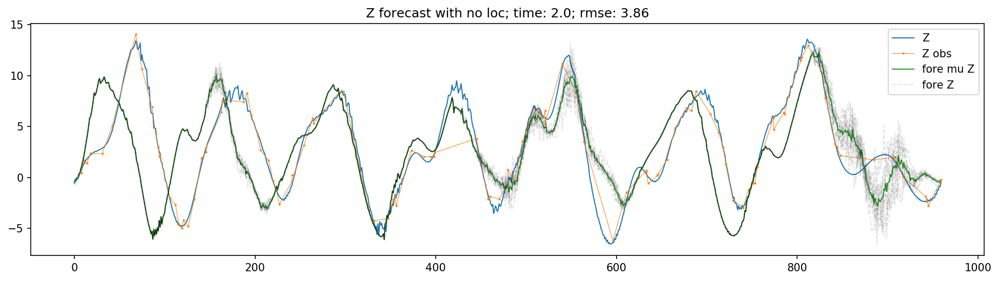

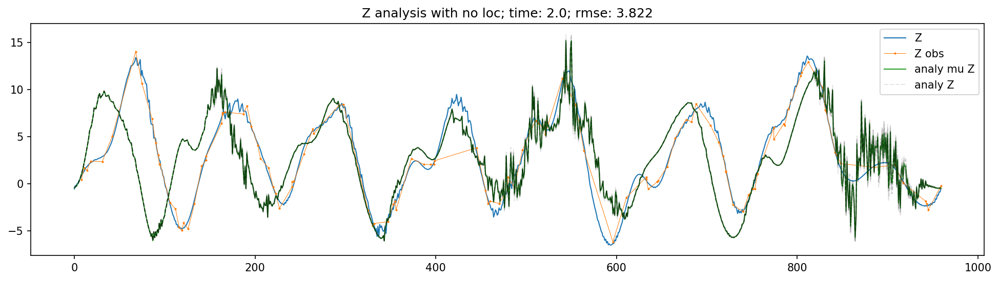

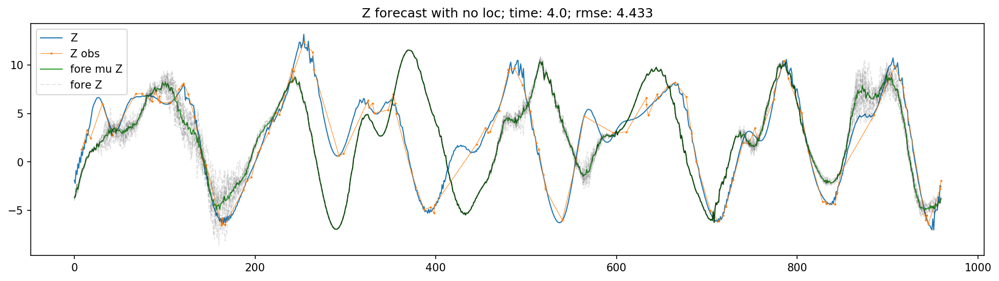

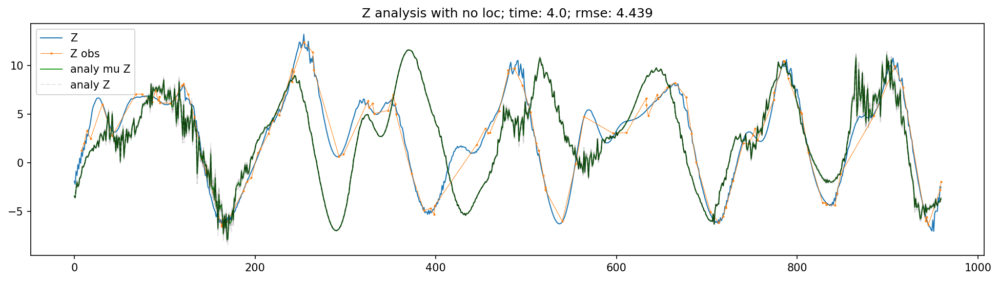

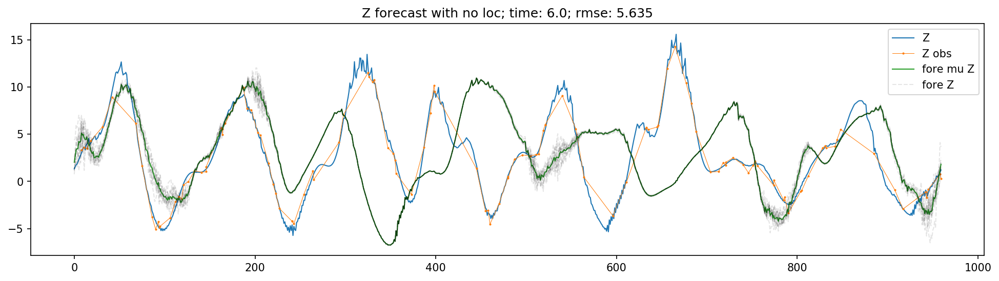

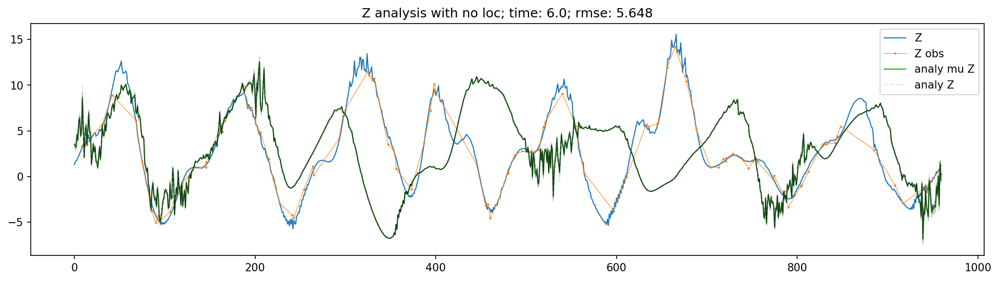

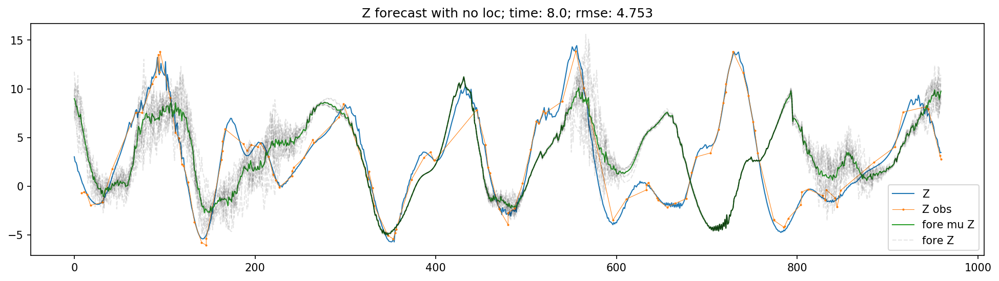

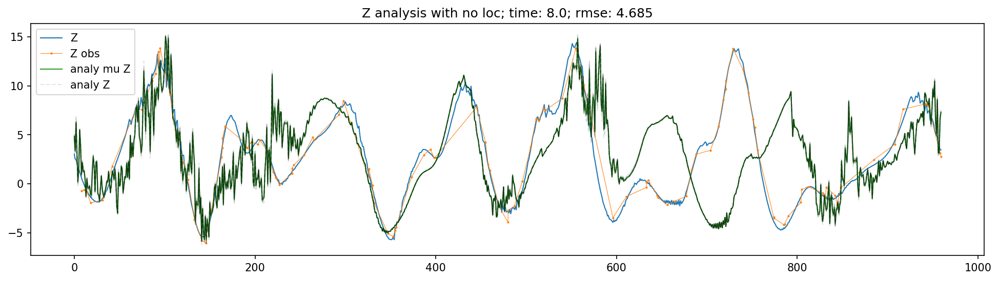

In [62]:
times_to_see = 2 * np.arange(5, dtype=float)
for this_time in times_to_see:
    
    this_ens = Zf_ens_ts.sel(time=this_time)
    
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_ts.sel(time=this_time), linewidth=1)
    plt.plot(Z_obs_loc, Z_obs_ts.sel(time=this_time), '-o', markersize=1, linewidth=0.5)
    plt.plot(this_ens.mean(dim='ens_num'), linewidth=1)
    plt.plot(this_ens, 'k--', alpha=.1, linewidth=1)
    plt.legend(['Z', 'Z obs', 'fore mu Z', 'fore Z'])

    mu = this_ens.mean(dim='ens_num')
    rmse = np.sqrt(((mu.values - Z_ts.sel(time=this_time).values)**2).mean())
    plt.title(f'Z forecast with {atitle}; time: {this_time:0.2}; rmse: {rmse:0.4}')


    this_ens = Za_ens_ts.sel(time=this_time)

    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_ts.sel(time=this_time), linewidth=1)
    plt.plot(Z_obs_loc, Z_obs_ts.sel(time=this_time), '-o', markersize=1, linewidth=0.5)
    plt.plot(this_ens.mean(dim='ens_num'), linewidth=1)
    plt.plot(this_ens, 'k--', alpha=.1, linewidth=1)
    plt.legend(['Z', 'Z obs', 'analy mu Z', 'analy Z'])

    mu = this_ens.mean(dim='ens_num')
    rmse = np.sqrt(((mu.values - Z_ts.sel(time=this_time).values)**2).mean())
    plt.title(f'Z analysis with {atitle}; time: {this_time:0.2}; rmse: {rmse:0.4}')

In [63]:
rmse_Z_nl1 = np.sqrt(((Zf_ens_ts.mean(dim='ens_num') - Z_ts)**2).mean(dim='loc'))
sd_Z_nl1 = np.sqrt((Zf_ens_ts.var(dim='ens_num').mean(dim='loc')))

rmse_X_nl1 = np.sqrt(((Xf_ens_ts.mean(dim='ens_num') - X_ts)**2).mean(dim='loc'))
sd_X_nl1 = np.sqrt((Xf_ens_ts.var(dim='ens_num').mean(dim='loc')))

# Cycle with standard localization

In [64]:
atitle='standard loc'

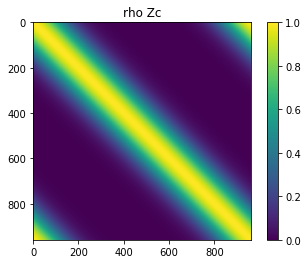

In [65]:
# rho0_Zf = 5
# rho_Zf = np.arange(N_Z)
# rho_Zf = np.minimum(np.abs(N_Z - rho_Zf)%N_Z, rho_Zf)
# rho_Zf = np.exp(-(rho_Zf**2)/(2*rho0_Zf**2))
# rho_Zf = sp.linalg.circulant(rho_Zf)
# imshow(rho_Zf, 'rho Zf',
#        vmin=0, vmax=1)
# imshow(rho_Zf[:20, :20], 'rho Zf zoom',
#        vmin=0, vmax=1)

rho0_Zc = 100
rho_Zc = np.arange(N_Z)
rho_Zc = np.minimum(np.abs(N_Z - rho_Zc)%N_Z, rho_Zc)
rho_Zc = np.exp(-(rho_Zc**2)/(2*rho0_Zc**2))
rho_Zc = sp.linalg.circulant(rho_Zc)
imshow(rho_Zc, 'rho Zc',
       vmin=0, vmax=1)

cycle_dict = {'X0_ens': X0_ens, 'Z0_ens': Z0_ens,
              'X_obs_ts': X_obs_ts, 'Z_obs_ts': Z_obs_ts,
              'R_X': R_Xc, 'R_Z': R_Z,
              'H_X': H_Xc, 'H_Z': H_Z,
              'dt': dt,
              'coarse': coarse,
              'rho_Zc': rho_Zc,
              'H_sub': H_sub,
              'R_sub': R_sub,
              'assim_type': 'standard loc'}

In [66]:
importlib.reload(assimilate)
importlib.reload(utilities)

X_ens_ts, Z_ens_ts = assimilate.cycle_KF_LM3(**cycle_dict)

0.0
assimed
pushed Z
pushed X
0.1
assimed
pushed Z
pushed X
0.2
assimed
pushed Z
pushed X
0.3
assimed
pushed Z
pushed X
0.4
assimed
pushed Z
pushed X
0.5
assimed
pushed Z
pushed X
0.6
assimed
pushed Z
pushed X
0.7
assimed
pushed Z
pushed X
0.8
assimed
pushed Z
pushed X
0.9
assimed
pushed Z
pushed X
1.0
assimed
pushed Z
pushed X
1.1
assimed
pushed Z
pushed X
1.2
assimed
pushed Z
pushed X
1.3
assimed
pushed Z
pushed X
1.4
assimed
pushed Z
pushed X
1.5
assimed
pushed Z
pushed X
1.6
assimed
pushed Z
pushed X
1.7
assimed
pushed Z
pushed X
1.8
assimed
pushed Z
pushed X
1.9
assimed
pushed Z
pushed X
2.0
assimed
pushed Z
pushed X
2.1
assimed
pushed Z
pushed X
2.2
assimed
pushed Z
pushed X
2.3
assimed
pushed Z
pushed X
2.4
assimed
pushed Z
pushed X
2.5
assimed
pushed Z
pushed X
2.6
assimed
pushed Z
pushed X
2.7
assimed
pushed Z
pushed X
2.8
assimed
pushed Z
pushed X
2.9
assimed
pushed Z
pushed X
3.0
assimed
pushed Z
pushed X
3.1
assimed
pushed Z
pushed X
3.2
assimed
pushed Z
pushed X
3.3
assime

pushed X
26.8
assimed
pushed Z
pushed X
26.9
assimed
pushed Z
pushed X
27.0
assimed
pushed Z
pushed X
27.1
assimed
pushed Z
pushed X
27.2
assimed
pushed Z
pushed X
27.3
assimed
pushed Z
pushed X
27.4
assimed
pushed Z
pushed X
27.5
assimed
pushed Z
pushed X
27.6
assimed
pushed Z
pushed X
27.7
assimed
pushed Z
pushed X
27.8
assimed
pushed Z
pushed X
27.9
assimed
pushed Z
pushed X
28.0
assimed
pushed Z
pushed X
28.1
assimed
pushed Z
pushed X
28.2
assimed
pushed Z
pushed X
28.3
assimed
pushed Z
pushed X
28.4
assimed
pushed Z
pushed X
28.5
assimed
pushed Z
pushed X
28.6
assimed
pushed Z
pushed X
28.7
assimed
pushed Z
pushed X
28.8
assimed
pushed Z
pushed X
28.9
assimed
pushed Z
pushed X
29.0
assimed
pushed Z
pushed X
29.1
assimed
pushed Z
pushed X
29.2
assimed
pushed Z
pushed X
29.3
assimed
pushed Z
pushed X
29.4
assimed
pushed Z
pushed X
29.5
assimed
pushed Z
pushed X
29.6
assimed
pushed Z
pushed X
29.7
assimed
pushed Z
pushed X
29.8
assimed
pushed Z
pushed X
29.9
assimed
pushed Z
pushed X

In [67]:
Zf_ens_ts = [da.isel(time=slice(1, None)) for da in Z_ens_ts]
Zf_ens_ts = xr.concat(Zf_ens_ts, dim='time')
temp = xr.DataArray(
    data=Z0_ens[:, :, None],
    dims=Zf_ens_ts.dims,
    coords={'loc': Zf_ens_ts['loc'].values,
            'ens_num': Zf_ens_ts['ens_num'].values,
            'time': [0]})
Zf_ens_ts = xr.concat([temp, Zf_ens_ts], dim='time')
Zf_ens_ts['time'] = np.round(Zf_ens_ts.time.values, 3)

In [68]:
Za_ens_ts = [da.isel(time=slice(None, -1)) for da in Z_ens_ts]
Za_ens_ts = xr.concat(Za_ens_ts, dim='time')
Za_ens_ts['time'] = np.round(Za_ens_ts.time.values, 3)

In [69]:
Xf_ens_ts = [da.isel(time=slice(1, None)) for da in X_ens_ts]
Xf_ens_ts = xr.concat(Xf_ens_ts, dim='time')
temp = xr.DataArray(
    data=X0_ens[:, :, None],
    dims=Xf_ens_ts.dims,
    coords={'loc': Xf_ens_ts['loc'].values,
            'ens_num': Xf_ens_ts['ens_num'].values,
            'time': [0]})
Xf_ens_ts = xr.concat([temp, Xf_ens_ts], dim='time')
Xf_ens_ts['time'] = np.round(Xf_ens_ts.time.values, 3)

In [70]:
Xa_ens_ts = [da.isel(time=slice(None, -1)) for da in X_ens_ts]
Xa_ens_ts = xr.concat(Xa_ens_ts, dim='time')
Xa_ens_ts['time'] = np.round(Xa_ens_ts.time.values, 3)

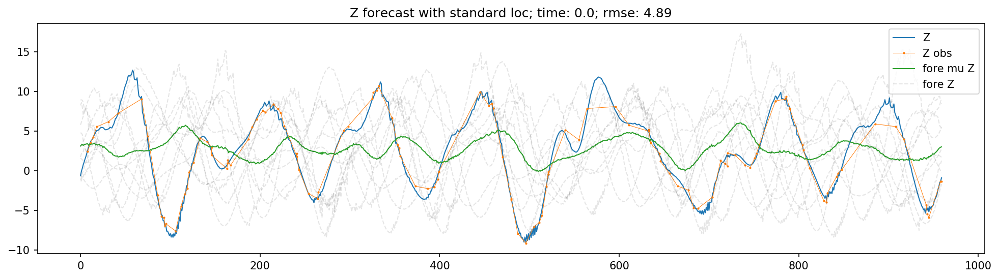

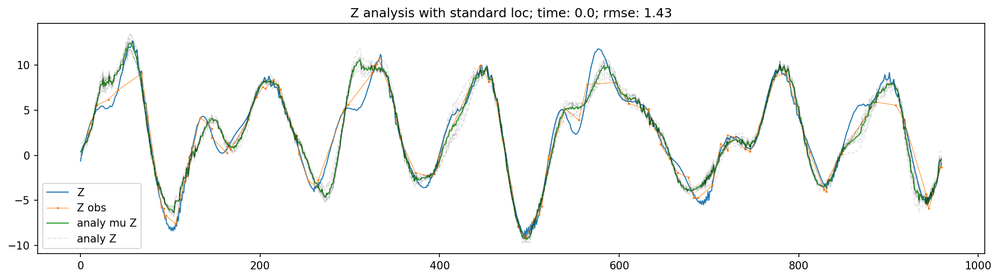

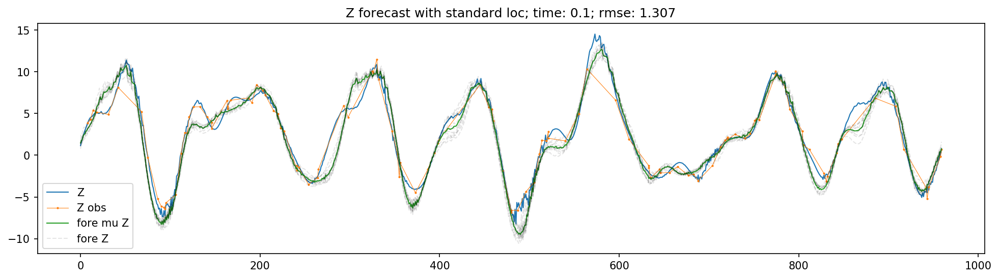

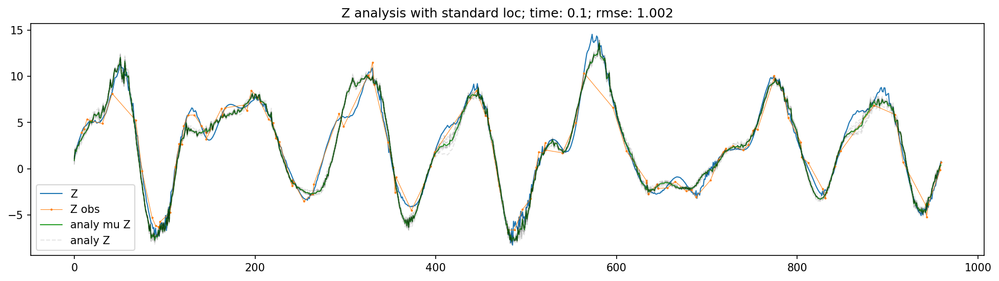

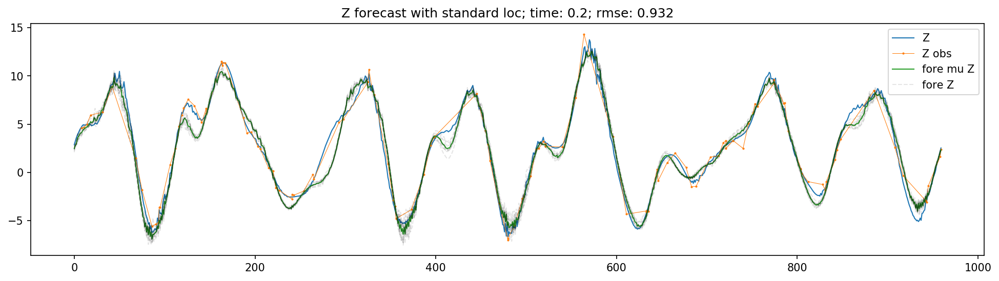

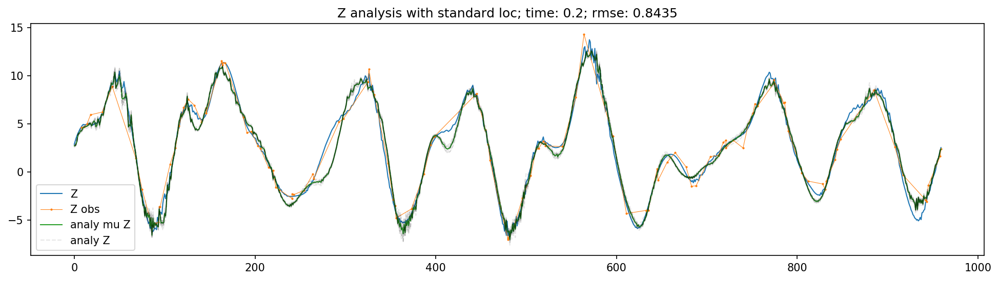

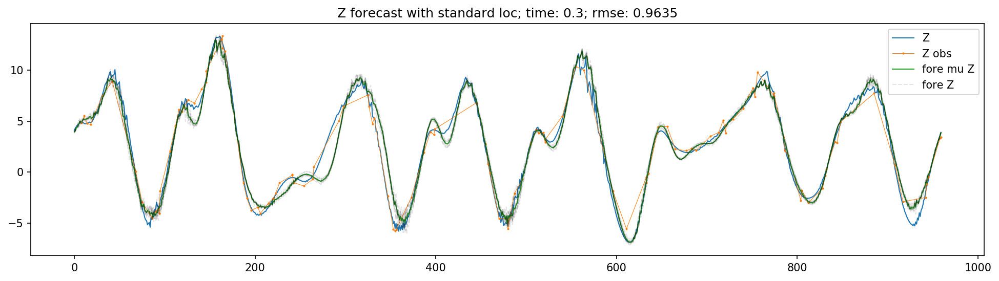

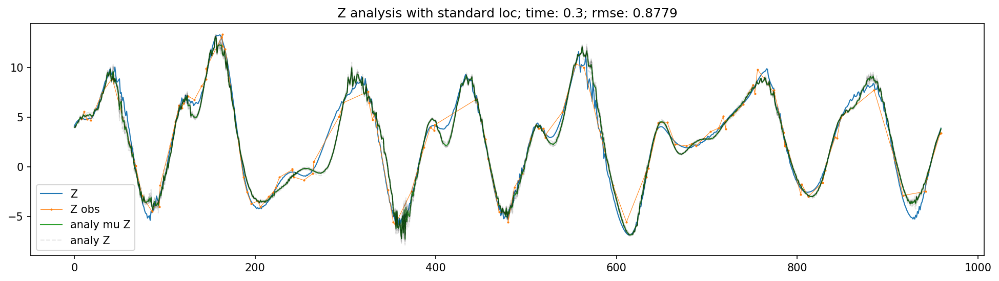

In [71]:
# times_to_see = 2 * np.arange(5, dtype=float)
times_to_see = t_obs[:4]
for this_time in times_to_see:
    
    this_ens = Zf_ens_ts.sel(time=this_time)
    
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_ts.sel(time=this_time), linewidth=1)
    plt.plot(Z_obs_loc, Z_obs_ts.sel(time=this_time), '-o', markersize=1, linewidth=0.5)
    plt.plot(this_ens.mean(dim='ens_num'), linewidth=1)
    plt.plot(this_ens, 'k--', alpha=.1, linewidth=1)
    plt.legend(['Z', 'Z obs', 'fore mu Z', 'fore Z'])

    mu = this_ens.mean(dim='ens_num')
    rmse = np.sqrt(((mu.values - Z_ts.sel(time=this_time).values)**2).mean())
    plt.title(f'Z forecast with {atitle}; time: {this_time:0.2}; rmse: {rmse:0.4}')


    this_ens = Za_ens_ts.sel(time=this_time)

    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_ts.sel(time=this_time), linewidth=1)
    plt.plot(Z_obs_loc, Z_obs_ts.sel(time=this_time), '-o', markersize=1, linewidth=0.5)
    plt.plot(this_ens.mean(dim='ens_num'), linewidth=1)
    plt.plot(this_ens, 'k--', alpha=.1, linewidth=1)
    plt.legend(['Z', 'Z obs', 'analy mu Z', 'analy Z'])

    mu = this_ens.mean(dim='ens_num')
    rmse = np.sqrt(((mu.values - Z_ts.sel(time=this_time).values)**2).mean())
    plt.title(f'Z analysis with {atitle}; time: {this_time:0.2}; rmse: {rmse:0.4}')

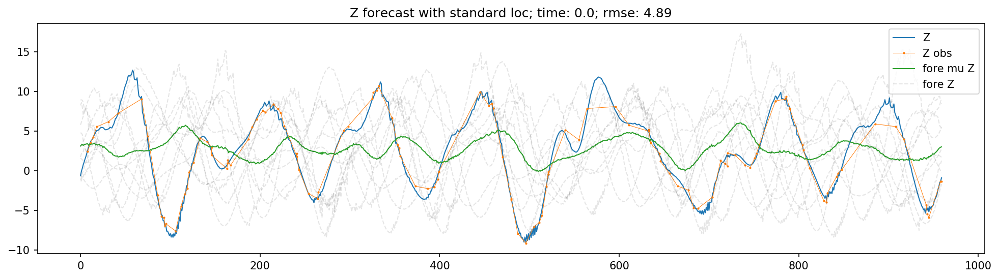

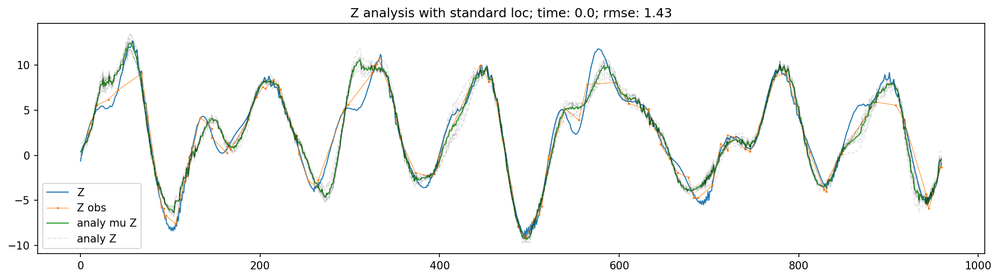

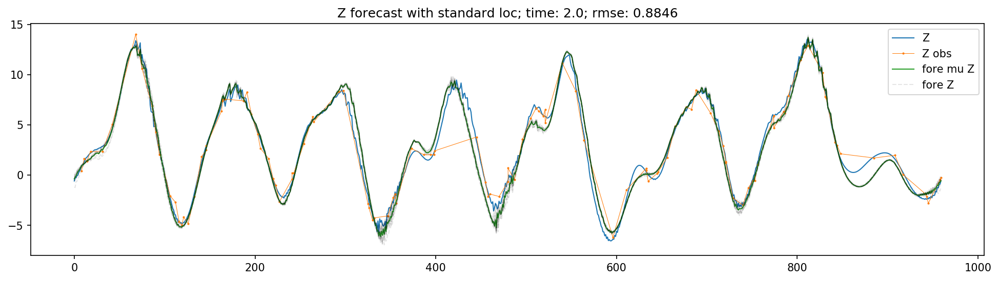

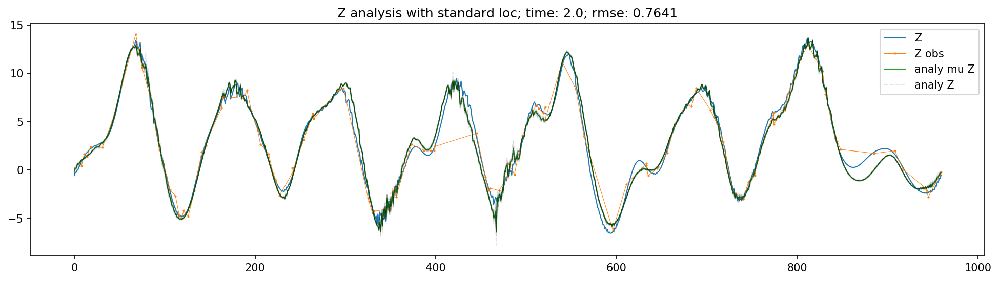

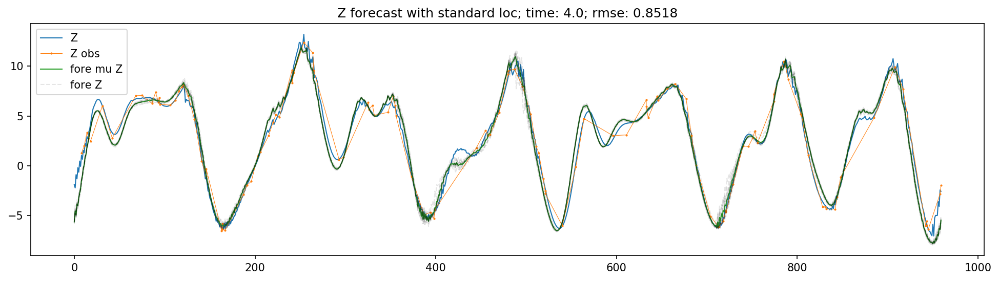

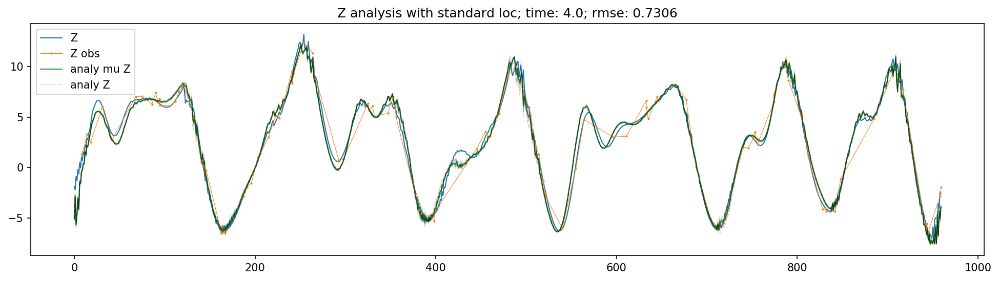

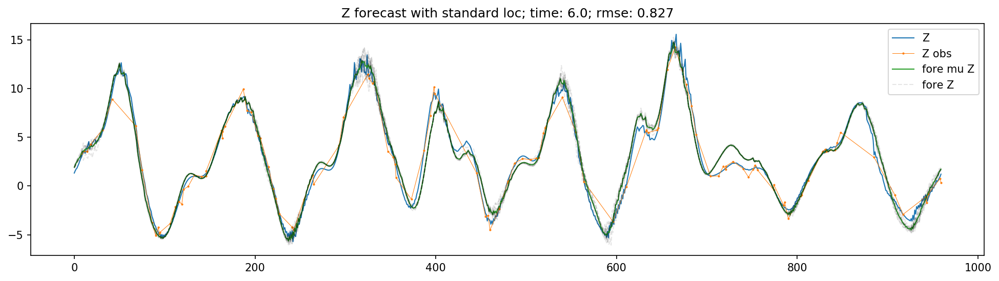

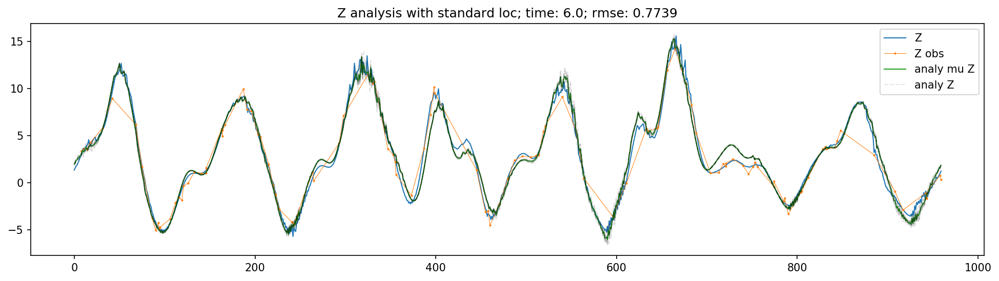

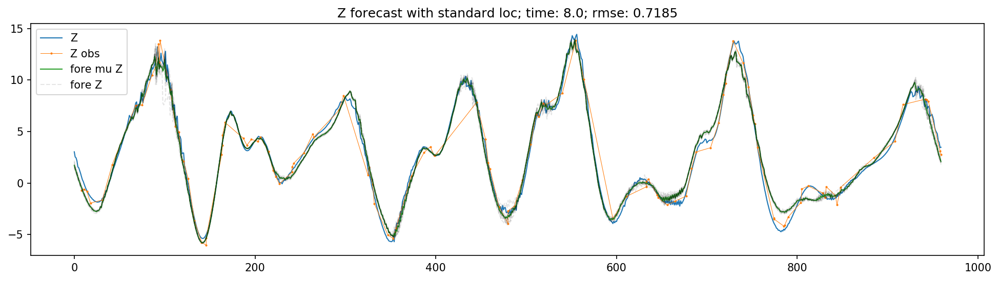

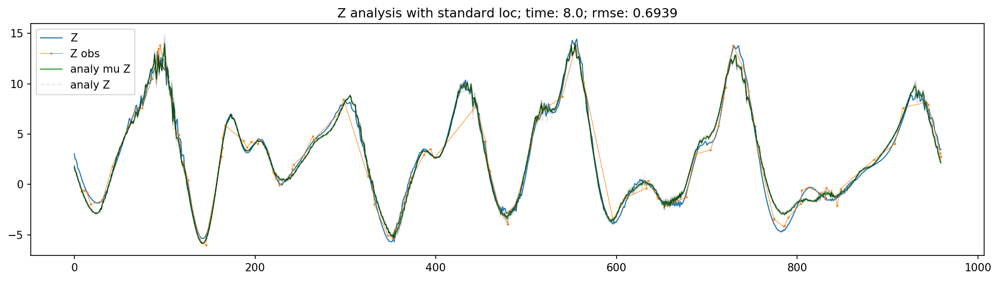

In [72]:
times_to_see = 2 * np.arange(5, dtype=float)
for this_time in times_to_see:
    
    this_ens = Zf_ens_ts.sel(time=this_time)
    
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_ts.sel(time=this_time), linewidth=1)
    plt.plot(Z_obs_loc, Z_obs_ts.sel(time=this_time), '-o', markersize=1, linewidth=0.5)
    plt.plot(this_ens.mean(dim='ens_num'), linewidth=1)
    plt.plot(this_ens, 'k--', alpha=.1, linewidth=1)
    plt.legend(['Z', 'Z obs', 'fore mu Z', 'fore Z'])

    mu = this_ens.mean(dim='ens_num')
    rmse = np.sqrt(((mu.values - Z_ts.sel(time=this_time).values)**2).mean())
    plt.title(f'Z forecast with {atitle}; time: {this_time:0.2}; rmse: {rmse:0.4}')


    this_ens = Za_ens_ts.sel(time=this_time)

    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_ts.sel(time=this_time), linewidth=1)
    plt.plot(Z_obs_loc, Z_obs_ts.sel(time=this_time), '-o', markersize=1, linewidth=0.5)
    plt.plot(this_ens.mean(dim='ens_num'), linewidth=1)
    plt.plot(this_ens, 'k--', alpha=.1, linewidth=1)
    plt.legend(['Z', 'Z obs', 'analy mu Z', 'analy Z'])

    mu = this_ens.mean(dim='ens_num')
    rmse = np.sqrt(((mu.values - Z_ts.sel(time=this_time).values)**2).mean())
    plt.title(f'Z analysis with {atitle}; time: {this_time:0.2}; rmse: {rmse:0.4}')

In [73]:
rmse_Z_st1 = np.sqrt(((Zf_ens_ts.mean(dim='ens_num') - Z_ts)**2).mean(dim='loc'))
sd_Z_st1 = np.sqrt((Zf_ens_ts.var(dim='ens_num').mean(dim='loc')))

rmse_X_st1 = np.sqrt(((Xf_ens_ts.mean(dim='ens_num') - X_ts)**2).mean(dim='loc'))
sd_X_st1 = np.sqrt((Xf_ens_ts.var(dim='ens_num').mean(dim='loc')))

# Cycle with SVD localization 

In [74]:
atitle='SVD loc'

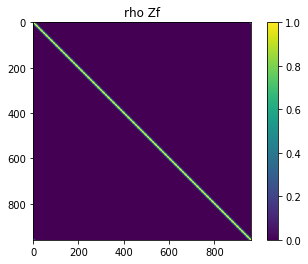

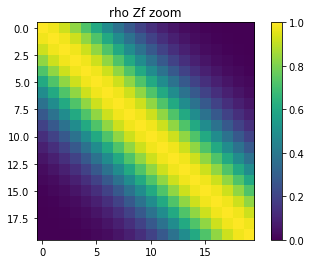

In [75]:
rho0_Zf = 5
rho_Zf = np.arange(N_Z)
rho_Zf = np.minimum(np.abs(N_Z - rho_Zf)%N_Z, rho_Zf)
rho_Zf = np.exp(-(rho_Zf**2)/(2*rho0_Zf**2))
rho_Zf = sp.linalg.circulant(rho_Zf)
imshow(rho_Zf, 'rho Zf',
       vmin=0, vmax=1)
imshow(rho_Zf[:20, :20], 'rho Zf zoom',
       vmin=0, vmax=1)

# rho0_Zc = 100
# rho_Zc = np.arange(N_Z)
# rho_Zc = np.minimum(np.abs(N_Z - rho_Zc)%N_Z, rho_Zc)
# rho_Zc = np.exp(-(rho_Zc**2)/(2*rho0_Zc**2))
# rho_Zc = sp.linalg.circulant(rho_Zc)
# rho_Zc = np.ones_like(rho_Zc)
# imshow(rho_Zc, 'rho Zc',
#        vmin=0, vmax=1)

rho0_Zc = None

cycle_dict = {'X0_ens': X0_ens, 'Z0_ens': Z0_ens,
              'X_obs_ts': X_obs_ts, 'Z_obs_ts': Z_obs_ts,
              'R_X': R_Xc, 'R_Z': R_Z,
              'H_X': H_Xc, 'H_Z': H_Z,
              'dt': dt,
              'coarse': coarse,
              'rho_Zc': rho_Zc,
              'rho_Zf': rho_Zf,
              'H_sub': H_sub, 'R_sub': R_sub,
              'assim_type': 'SVD_loc'}

In [76]:
importlib.reload(assimilate)
importlib.reload(utilities)

X_ens_ts, Z_ens_ts = assimilate.cycle_KF_LM3(**cycle_dict)

0.0
assimed
pushed Z
pushed X
0.1
assimed
pushed Z
pushed X
0.2
assimed
pushed Z
pushed X
0.3
assimed
pushed Z
pushed X
0.4
assimed
pushed Z
pushed X
0.5
assimed
pushed Z
pushed X
0.6
assimed
pushed Z
pushed X
0.7
assimed
pushed Z
pushed X
0.8
assimed
pushed Z
pushed X
0.9
assimed
pushed Z
pushed X
1.0
assimed
pushed Z
pushed X
1.1
assimed
pushed Z
pushed X
1.2
assimed
pushed Z
pushed X
1.3
assimed
pushed Z
pushed X
1.4
assimed
pushed Z
pushed X
1.5
assimed
pushed Z
pushed X
1.6
assimed
pushed Z
pushed X
1.7
assimed
pushed Z
pushed X
1.8
assimed
pushed Z
pushed X
1.9
assimed
pushed Z
pushed X
2.0
assimed
pushed Z
pushed X
2.1
assimed
pushed Z
pushed X
2.2
assimed
pushed Z
pushed X
2.3
assimed
pushed Z
pushed X
2.4
assimed
pushed Z
pushed X
2.5
assimed
pushed Z
pushed X
2.6
assimed
pushed Z
pushed X
2.7
assimed
pushed Z
pushed X
2.8
assimed
pushed Z
pushed X
2.9
assimed
pushed Z
pushed X
3.0
assimed
pushed Z
pushed X
3.1
assimed
pushed Z
pushed X
3.2
assimed
pushed Z
pushed X
3.3
assime

pushed X
26.8
assimed
pushed Z
pushed X
26.9
assimed
pushed Z
pushed X
27.0
assimed
pushed Z
pushed X
27.1
assimed
pushed Z
pushed X
27.2
assimed
pushed Z
pushed X
27.3
assimed
pushed Z
pushed X
27.4
assimed
pushed Z
pushed X
27.5
assimed
pushed Z
pushed X
27.6
assimed
pushed Z
pushed X
27.7
assimed
pushed Z
pushed X
27.8
assimed
pushed Z
pushed X
27.9
assimed
pushed Z
pushed X
28.0
assimed
pushed Z
pushed X
28.1
assimed
pushed Z
pushed X
28.2
assimed
pushed Z
pushed X
28.3
assimed
pushed Z
pushed X
28.4
assimed
pushed Z
pushed X
28.5
assimed
pushed Z
pushed X
28.6
assimed
pushed Z
pushed X
28.7
assimed
pushed Z
pushed X
28.8
assimed
pushed Z
pushed X
28.9
assimed
pushed Z
pushed X
29.0
assimed
pushed Z
pushed X
29.1
assimed
pushed Z
pushed X
29.2
assimed
pushed Z
pushed X
29.3
assimed
pushed Z
pushed X
29.4
assimed
pushed Z
pushed X
29.5
assimed
pushed Z
pushed X
29.6
assimed
pushed Z
pushed X
29.7
assimed
pushed Z
pushed X
29.8
assimed
pushed Z
pushed X
29.9
assimed
pushed Z
pushed X

In [77]:
Zf_ens_ts = [da.isel(time=slice(1, None)) for da in Z_ens_ts]
Zf_ens_ts = xr.concat(Zf_ens_ts, dim='time')
temp = xr.DataArray(
    data=Z0_ens[:, :, None],
    dims=Zf_ens_ts.dims,
    coords={'loc': Zf_ens_ts['loc'].values,
            'ens_num': Zf_ens_ts['ens_num'].values,
            'time': [0]})
Zf_ens_ts = xr.concat([temp, Zf_ens_ts], dim='time')
Zf_ens_ts['time'] = np.round(Zf_ens_ts.time.values, 3)

In [78]:
Za_ens_ts = [da.isel(time=slice(None, -1)) for da in Z_ens_ts]
Za_ens_ts = xr.concat(Za_ens_ts, dim='time')
Za_ens_ts['time'] = np.round(Za_ens_ts.time.values, 3)

In [79]:
Xf_ens_ts = [da.isel(time=slice(1, None)) for da in X_ens_ts]
Xf_ens_ts = xr.concat(Xf_ens_ts, dim='time')
temp = xr.DataArray(
    data=X0_ens[:, :, None],
    dims=Xf_ens_ts.dims,
    coords={'loc': Xf_ens_ts['loc'].values,
            'ens_num': Xf_ens_ts['ens_num'].values,
            'time': [0]})
Xf_ens_ts = xr.concat([temp, Xf_ens_ts], dim='time')
Xf_ens_ts['time'] = np.round(Xf_ens_ts.time.values, 3)

In [80]:
Xa_ens_ts = [da.isel(time=slice(None, -1)) for da in X_ens_ts]
Xa_ens_ts = xr.concat(Xa_ens_ts, dim='time')
Xa_ens_ts['time'] = np.round(Xa_ens_ts.time.values, 3)

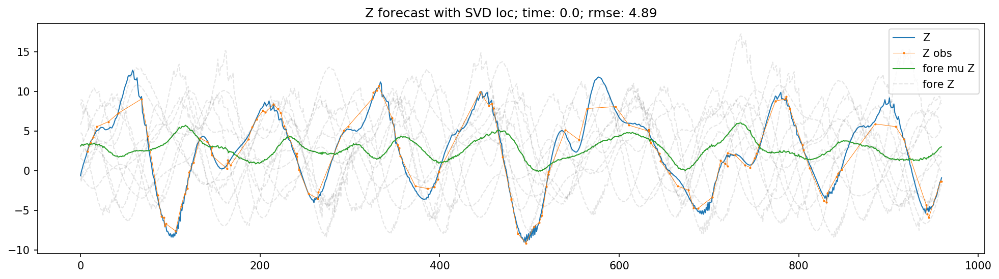

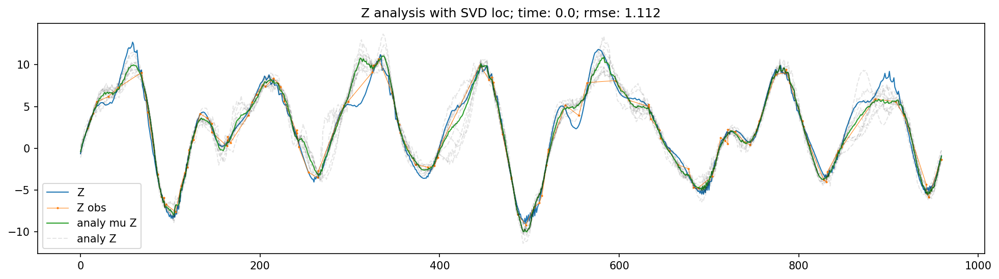

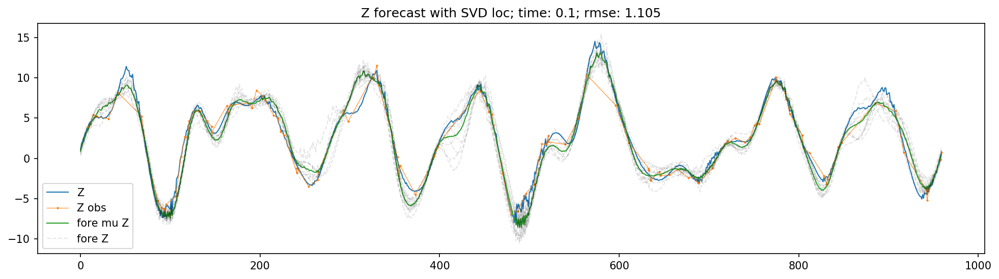

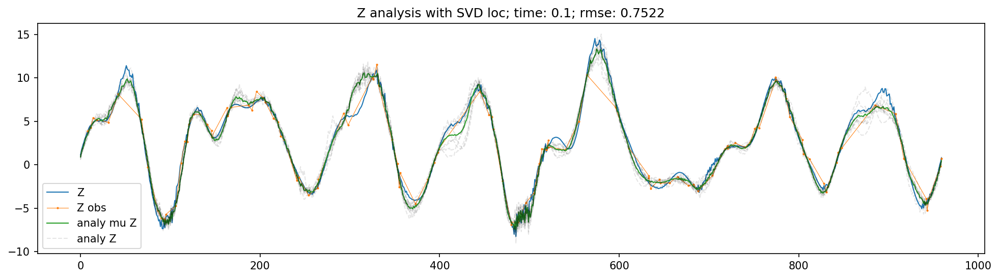

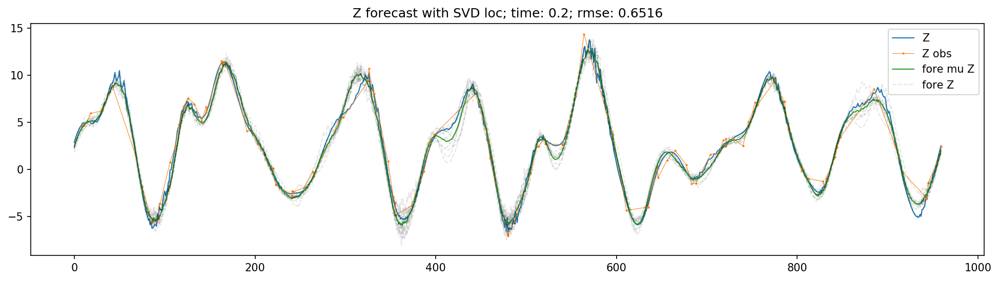

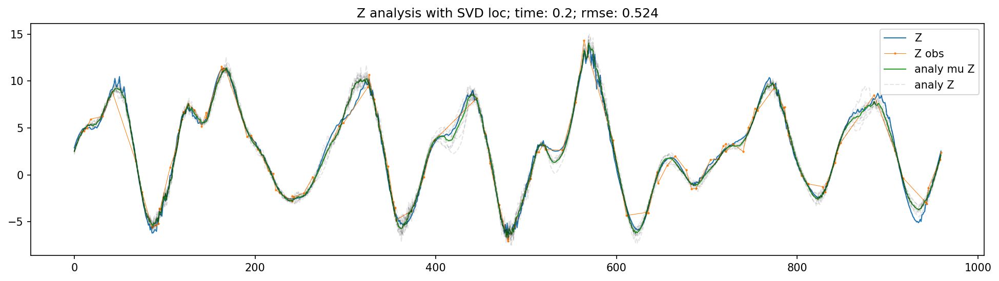

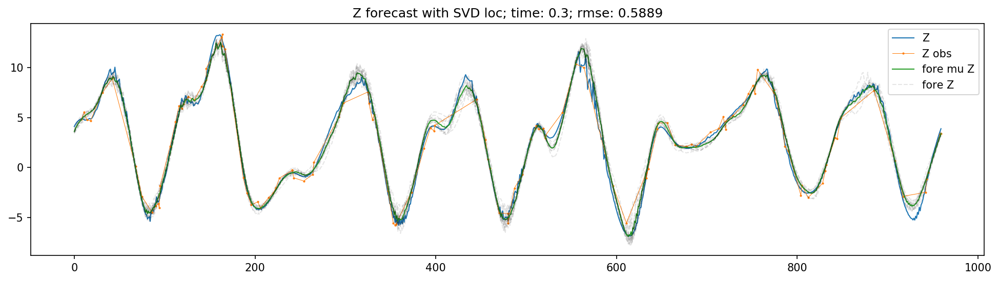

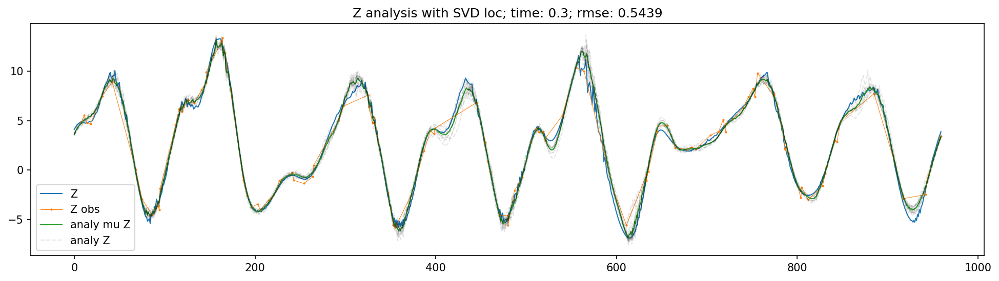

In [81]:
times_to_see = t_obs[:4]
for this_time in times_to_see:
    
    this_ens = Zf_ens_ts.sel(time=this_time)
    
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_ts.sel(time=this_time), linewidth=1)
    plt.plot(Z_obs_loc, Z_obs_ts.sel(time=this_time), '-o', markersize=1, linewidth=0.5)
    plt.plot(this_ens.mean(dim='ens_num'), linewidth=1)
    plt.plot(this_ens, 'k--', alpha=.1, linewidth=1)
    plt.legend(['Z', 'Z obs', 'fore mu Z', 'fore Z'])

    mu = this_ens.mean(dim='ens_num')
    rmse = np.sqrt(((mu.values - Z_ts.sel(time=this_time).values)**2).mean())
    plt.title(f'Z forecast with {atitle}; time: {this_time:0.2}; rmse: {rmse:0.4}')


    this_ens = Za_ens_ts.sel(time=this_time)

    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(Z_ts.sel(time=this_time), linewidth=1)
    plt.plot(Z_obs_loc, Z_obs_ts.sel(time=this_time), '-o', markersize=1, linewidth=0.5)
    plt.plot(this_ens.mean(dim='ens_num'), linewidth=1)
    plt.plot(this_ens, 'k--', alpha=.1, linewidth=1)
    plt.legend(['Z', 'Z obs', 'analy mu Z', 'analy Z'])

    mu = this_ens.mean(dim='ens_num')
    rmse = np.sqrt(((mu.values - Z_ts.sel(time=this_time).values)**2).mean())
    plt.title(f'Z analysis with {atitle}; time: {this_time:0.2}; rmse: {rmse:0.4}')

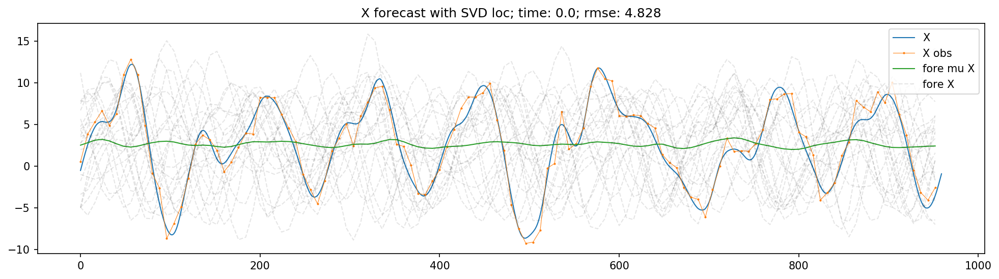

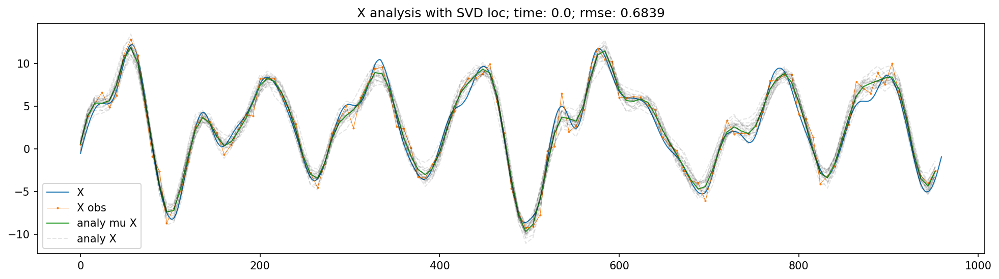

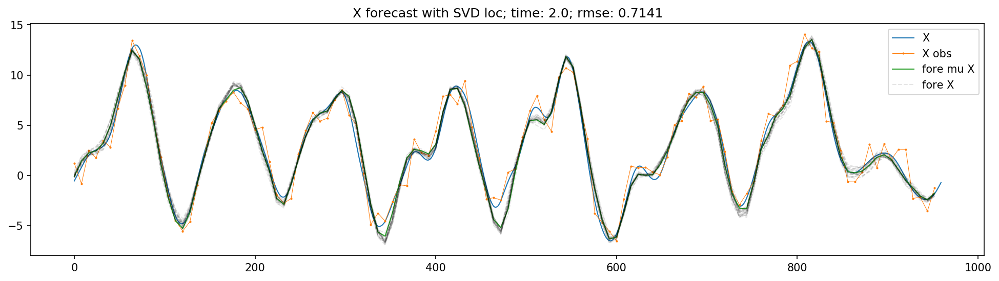

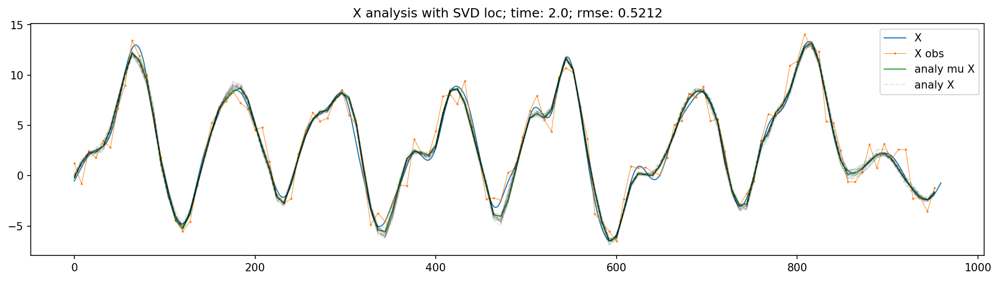

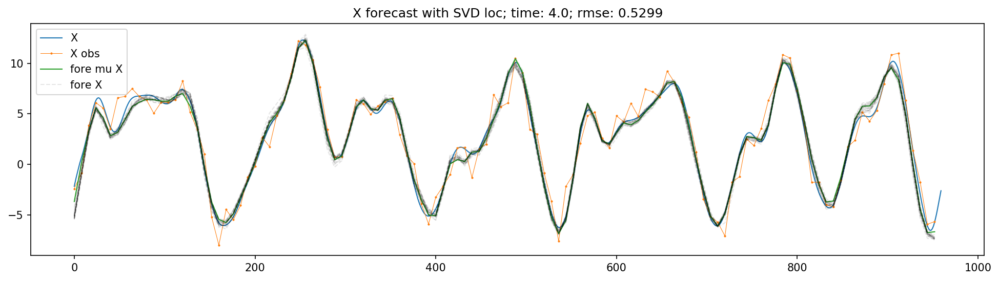

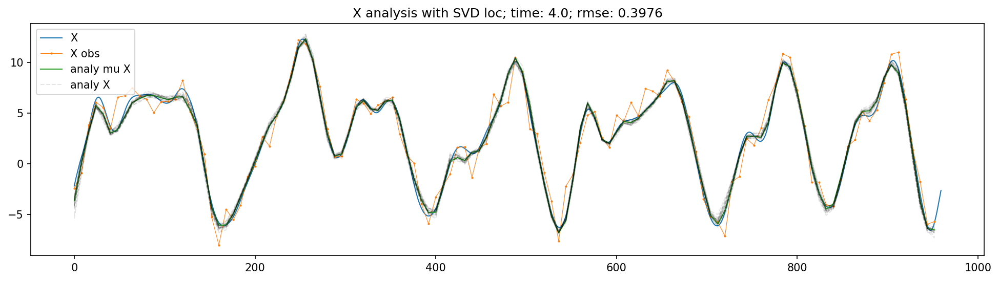

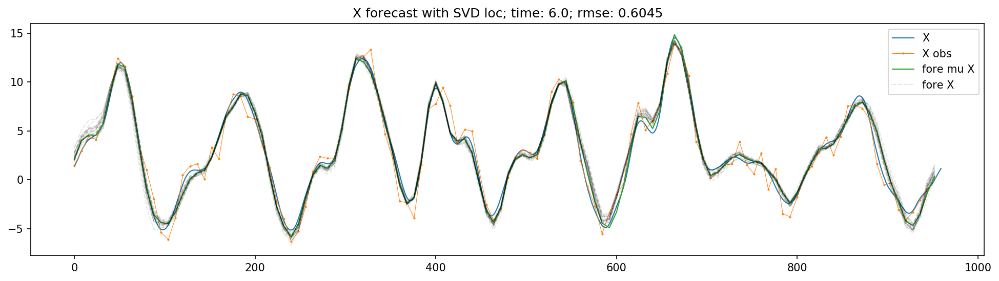

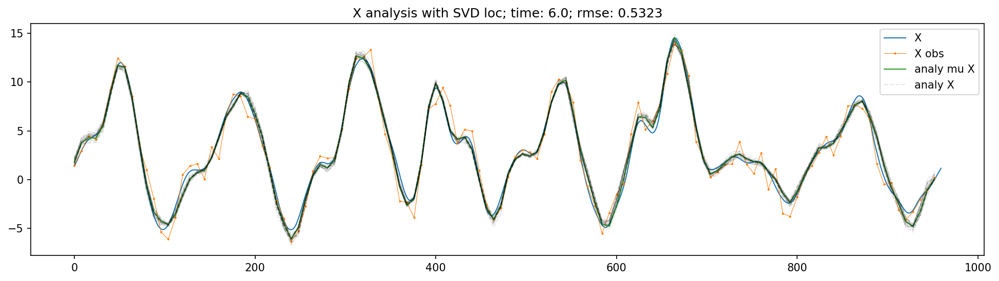

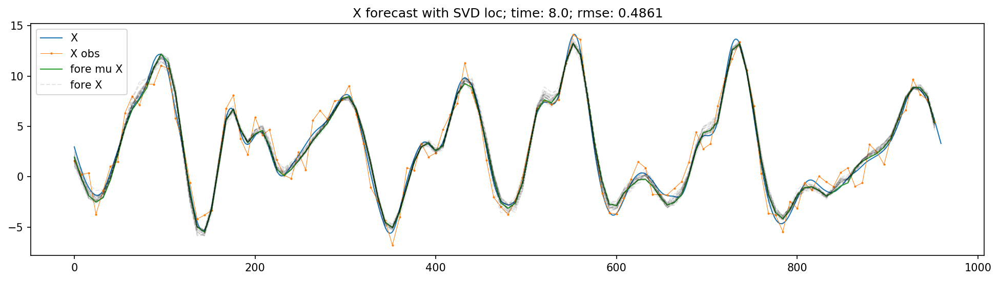

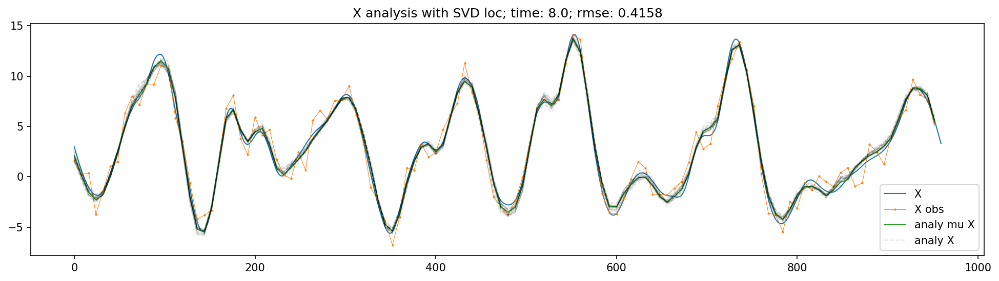

In [82]:
times_to_see = 2 * np.arange(5, dtype=float)
for this_time in times_to_see:
    
    this_ens = Xf_ens_ts.sel(time=this_time)
    
    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(X_ts.sel(time=this_time), linewidth=1)
    plt.plot(X_obs_loc, X_obs_ts.sel(time=this_time), '-o', markersize=1, linewidth=0.5)
    plt.plot(x_Xc, this_ens.mean(dim='ens_num'), linewidth=1)
    plt.plot(x_Xc, this_ens.sel(ens_num=slice(0, 20)), 'k--', alpha=.1, linewidth=1)
    plt.legend(['X', 'X obs', 'fore mu X', 'fore X'])

    mu = this_ens.mean(dim='ens_num')
    rmse = np.sqrt(((mu.values - X_ts.sel(time=this_time).values[::coarse])**2).mean())
    plt.title(f'X forecast with {atitle}; time: {this_time:0.2}; rmse: {rmse:0.4}')


    this_ens = Xa_ens_ts.sel(time=this_time)

    figsize = plt.figaspect(1/4)
    plt.figure(dpi=150, figsize=figsize)
    plt.plot(X_ts.sel(time=this_time), linewidth=1)
    plt.plot(X_obs_loc, X_obs_ts.sel(time=this_time), '-o', markersize=1, linewidth=0.5)
    plt.plot(x_Xc, this_ens.mean(dim='ens_num'), linewidth=1)
    plt.plot(x_Xc, this_ens.sel(ens_num=slice(0, 20)), 'k--', alpha=.1, linewidth=1)
    plt.legend(['X', 'X obs', 'analy mu X', 'analy X'])

    mu = this_ens.mean(dim='ens_num')
    rmse = np.sqrt(((mu.values - X_ts.sel(time=this_time).values[::coarse])**2).mean())
    plt.title(f'X analysis with {atitle}; time: {this_time:0.2}; rmse: {rmse:0.4}')

In [83]:
rmse_Z_svd1 = np.sqrt(((Zf_ens_ts.mean(dim='ens_num') - Z_ts)**2).mean(dim='loc'))
sd_Z_svd1 = np.sqrt((Zf_ens_ts.var(dim='ens_num').mean(dim='loc')))

rmse_X_svd1 = np.sqrt(((Xf_ens_ts.mean(dim='ens_num') - X_ts)**2).mean(dim='loc'))
sd_X_svd1 = np.sqrt((Xf_ens_ts.var(dim='ens_num').mean(dim='loc')))

# RMSE plots

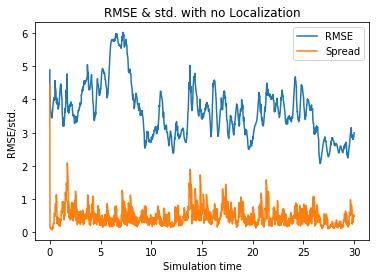

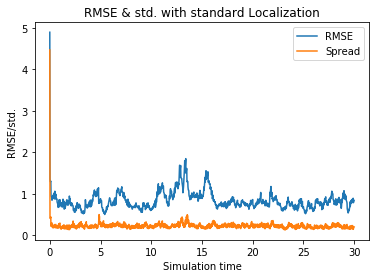

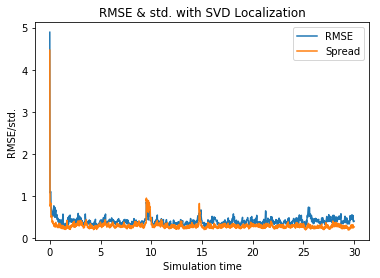

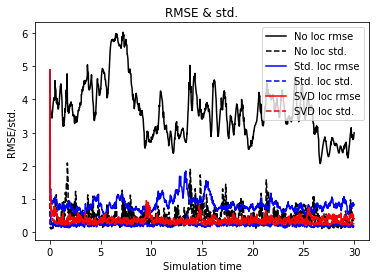

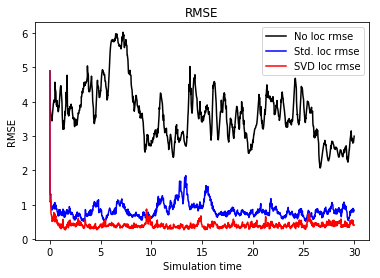

In [84]:
plt.figure()
plt.plot(t_kf, rmse_Z_nl1.sel(time=slice(0, T_KF)))
plt.plot(t_kf, sd_Z_nl1.sel(time=slice(0, T_KF)))
plt.xlabel('Simulation time')
plt.ylabel('RMSE/std.')
plt.legend(['RMSE', 'Spread'])
plt.title('RMSE & std. with no Localization')

plt.figure()
plt.plot(t_kf, rmse_Z_st1.sel(time=slice(0, T_KF)))
plt.plot(t_kf, sd_Z_st1.sel(time=slice(0, T_KF)))
plt.xlabel('Simulation time')
plt.ylabel('RMSE/std.')
plt.legend(['RMSE', 'Spread'])
plt.title('RMSE & std. with standard Localization')

plt.figure()
plt.plot(t_kf, rmse_Z_svd1.sel(time=slice(0, T_KF)))
plt.plot(t_kf, sd_Z_svd1.sel(time=slice(0, T_KF)))
plt.xlabel('Simulation time')
plt.ylabel('RMSE/std.')
plt.legend(['RMSE', 'Spread'])
plt.title('RMSE & std. with SVD Localization')


plt.figure()
plt.plot(t_kf, rmse_Z_nl1.sel(time=slice(0, T_KF)), 'k')
plt.plot(t_kf, sd_Z_nl1.sel(time=slice(0, T_KF)), 'k--')
plt.plot(t_kf, rmse_Z_st1.sel(time=slice(0, T_KF)), 'b')
plt.plot(t_kf, sd_Z_st1.sel(time=slice(0, T_KF)), 'b--')
plt.plot(t_kf, rmse_Z_svd1.sel(time=slice(0, T_KF)), 'r')
plt.plot(t_kf, sd_Z_svd1.sel(time=slice(0, T_KF)), 'r--')
plt.xlabel('Simulation time')
plt.ylabel('RMSE/std.')
plt.title('RMSE & std.')
plt.legend(['No loc rmse', 'No loc std.',
            'Std. loc rmse', 'Std. loc std.',
            'SVD loc rmse', 'SVD loc std.'])


plt.figure()
plt.plot(t_kf, rmse_Z_nl1.sel(time=slice(0, T_KF)), 'k')
plt.plot(t_kf, rmse_Z_st1.sel(time=slice(0, T_KF)), 'b')
plt.plot(t_kf, rmse_Z_svd1.sel(time=slice(0, T_KF)), 'r')
plt.xlabel('Simulation time')
plt.ylabel('RMSE')
plt.title('RMSE')
plt.legend(['No loc rmse',
            'Std. loc rmse',
            'SVD loc rmse'])